In [1]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t6p6.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los6.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)


,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

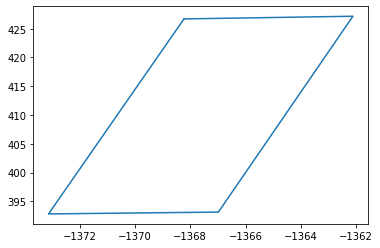

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

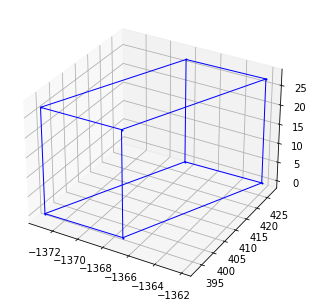

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▌                                                                              | 57/8644 [00:00<00:47, 182.47it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:18<00:00, 462.09it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+21*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [21]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=1.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [22]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=1.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [23]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if fss_phi_difference < 48:
            return None, None
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= 8
#         LBuildingLoss=1
        interface1=TXPower+ 0-pathloss_UMi- LBodyLoss + G_Rx_5G 
        return interface1,pathloss_UMi

In [24]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if fss_phi_difference < 48:
            return None, None
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= 8
#         LBuildingLoss=1
        interface2=TXPower+ 0-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa
    

In [25]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if fss_phi_difference < 48:
            return None, None
        if output: print("fss_phi_difference:", fss_phi_difference)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= 8
#         LBuildingLoss=1
        interface3=TXPower+ 0-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [26]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [27]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e9, interference_type=None)
x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}

exclusion_zones = [500, 1000, 2000, 3000, 4000]
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, x)
        FSS_Y = np.append(FSS_Y, y)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e9, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 0)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_UMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_RMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        skipped_UEs = 0
        for j in range(len(FSS_X)):
            print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                     interface_UMi_W=np.append(interface_UMi_W,0)
#                     interface_UMa_W=np.append(interface_UMa_W,0)
#                     interface_RMa_W=np.append(interface_RMa_W,0)
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

#                     theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5,FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j])
                        print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        if interfaceumi is not None:
                            interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
                        else:
                            skipped_UEs += 1
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         print("UE:", k, "/ interference uma:", interfaceuma, "/ pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         print("UE:", k, "/ interference rma:", interfacerma, "/ pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)
        
        for exclusion_zone in exclusion_zones:
            if distance_UMi[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMi_W[exclusion_zone] = np.append(interface_UMi_W[exclusion_zone], np.sum(10 ** (interface_UMi_BS / 10)/(30-skipped_UEs)))
            if distance_UMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMa_W[exclusion_zone] = np.append(interface_UMa_W[exclusion_zone], np.sum(10 ** (interface_UMa_BS / 10)/(30-skipped_UEs)))
            if distance_RMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_RMa_W[exclusion_zone] = np.append(interface_RMa_W[exclusion_zone], np.sum(10 ** (interface_RMa_BS / 10)/(30-skipped_UEs)))
              
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi, I_N_UMa, I_N_RMa = dict(), dict(), dict()
    for exclusion_zone in exclusion_zones:
        I_N_UMi[exclusion_zone] = interface_UMi_W[exclusion_zone] / Noise_W
    if output: print('I/N UMi:', I_N_UMi) 
    for exclusion_zone in exclusion_zones:
        I_N_UMa[exclusion_zone] = interface_UMa_W[exclusion_zone] / Noise_W  
    if output: print('I/N UMa:', I_N_UMa)
    for exclusion_zone in exclusion_zones:
        I_N_RMa[exclusion_zone] = interface_RMa_W[exclusion_zone] / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight
        

In [28]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
# def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
#     if coarse:
#         theta = round(theta, rounding_precision)
#         phi = round(phi, rounding_precision)
#     if (theta, phi) in saved_tp:
#         # print(f'match found for ({theta}, {phi}), using that')
#         return saved_tp.get((theta, phi))
    
    
    
#     # return max_parameters
#     # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
#     result = optimize.brute(
#         lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
#         # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
#         ranges = [(-90, 90), (-180, 180)]
        
#     )
#     saved_tp[(theta, phi)] = tuple(x for x in result)
    
#     return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
# def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
#     summation = 0
#     # weighting multiplied by the superposition vector
#     for n in range(1, rows+1):
#         for m in range(1, cols+1):
#             # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
#             summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

#     return abs(summation)**2

# # antenna gain of 5G base station (represented by a single beam i)
# # def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
# #     beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

# #     return gain_antenna_element(theta, phi) + \
# #            10 * math.log10(beam_pattern)

# # space refers to D/λ
# def get_phi_min(space) -> float:
#     # Rec. ITU-R S.465-6
#     if space >= 50:
#         return max(1.0, 100 * (1 / space))
#     else:
#         return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
# def gain_fss_s1428(phi, phi_min) -> float:

#     if 0 < phi < phi_min:
#         return 32 - 25 * math.log10(phi_min)
#     elif phi_min <= phi < 48:
#         return 32 - 25 * math.log10(phi)
#     elif 48 <= phi <= 180:
#         return -10

#     # This function is only defined where phi is within (0, 180]
#     raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [29]:
from tqdm import tqdm
distance_RMa, distance_UMa, distance_UMi, line_of_sight = [np.empty([0]) for x in range(4)]
I_N_RMa_W, I_N_RMa_noAverage, I_N_UMa_W, I_N_UMa_noAverage, I_N_UMi_W, I_N_UMi_noAverage = [{exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones} for x in range(6)]

simulation_count = 10
for i in tqdm(range(simulation_count)):
    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)
    distance_RMa = np.append(distance_RMa, distance_RMa_single)
    distance_UMa = np.append(distance_UMa, distance_UMa_single)
    distance_UMi = np.append(distance_UMi, distance_UMi_single)

    I_N_groups = [
      (I_N_RMa_W, I_N_RMa_noAverage, I_N_RMa_single_W),
      (I_N_UMa_W, I_N_UMa_noAverage, I_N_UMa_single_W),
      (I_N_UMi_W, I_N_UMi_noAverage, I_N_UMi_single_W)
   ]
    for I_N_W, I_N_noAverage, I_N_single_W in I_N_groups:
        for exclusion_zone in exclusion_zones:
            I_N_W[exclusion_zone] = np.append(I_N_W[exclusion_zone], I_N_single_W[exclusion_zone])
            I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
    
    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0

# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     for exclusion_zone in exclusion_zones:
#         arr[exclusion_zone][arr[exclusion_zone] == -np.inf]=0
    
I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}
I_N_UMi = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMi_W[exclusion_zone])) for exclusion_zone in I_N_UMi_W}

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 37%|████████████████████████████                                                 | 2985/8177 [00:07<00:15, 331.19it/s]


 78%|████████████████████████████████████████████████████████████                 | 6378/8177 [00:14<00:03, 510.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 428.01it/s]

 17%|████████████▊                                                                | 1365/8177 [00:03<00:14, 478.11it/s]


 54%|█████████████████████████████████████████▉                                   | 4449/8177 [00:11<00:10, 372.48it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7737/8177 [00:18<00:01, 294.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 410.99it/s]

 32%|████████████████████████▎                                                    | 2586/8177 [00:06<00:16, 330.23it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5898/8177 [00:14<00:04, 488.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 424.60it/s]

  8%|██████▏                                                                       | 646/8177 [00:02<00:23, 318.42it/s]


 45%|██████████████████████████████████▍                                          | 3660/8177 [00:10<00:10, 450.54it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6728/8177 [00:17<00:02, 486.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:20<00:00, 395.17it/s]

 22%|█████████████████▏                                                           | 1825/8177 [00:04<00:12, 498.85it/s]


 64%|█████████████████████████████████████████████████                            | 5205/8177 [00:11<00:06, 469.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 444.08it/s]

  4%|███                                                                           | 315/8177 [00:01<00:20, 379.80it/s]


 45%|██████████████████████████████████▎                                          | 3641/8177 [00:08<00:08, 564.78it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7102/8177 [00:16<00:03, 351.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 443.08it/s]

 25%|███████████████████▎                                                         | 2046/8177 [00:05<00:14, 426.44it/s]


 65%|█████████████████████████████████████████████████▊                           | 5293/8177 [00:12<00:06, 432.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 427.97it/s]

  4%|██▊                                                                           | 296/8177 [00:01<00:21, 374.92it/s]


 43%|████████████████████████████████▉                                            | 3502/8177 [00:08<00:10, 449.96it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6896/8177 [00:15<00:02, 494.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 429.60it/s]

 23%|█████████████████▍                                                           | 1848/8177 [00:04<00:14, 451.65it/s]


 62%|███████████████████████████████████████████████▋                             | 5061/8177 [00:12<00:07, 444.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 426.38it/s]

  1%|█                                                                             | 107/8177 [00:00<00:36, 218.66it/s]


 40%|██████████████████████████████▌                                              | 3245/8177 [00:08<00:17, 283.02it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6649/8177 [00:15<00:03, 446.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 431.77it/s]

 20%|███████████████▎                                                             | 1626/8177 [00:04<00:15, 435.10it/s]


 60%|██████████████████████████████████████████████▎                              | 4922/8177 [00:11<00:07, 451.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 432.57it/s]

  1%|▌                                                                              | 55/8177 [00:00<00:34, 232.40it/s]


 39%|█████████████████████████████▊                                               | 3160/8177 [00:08<00:14, 336.73it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6525/8177 [00:15<00:03, 478.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 432.24it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:03<00:12, 511.99it/s]


 60%|██████████████████████████████████████████████                               | 4892/8177 [00:11<00:07, 454.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 439.98it/s]

  1%|▌                                                                              | 56/8177 [00:00<00:33, 240.22it/s]


 39%|██████████████████████████████▎                                              | 3223/8177 [00:08<00:16, 294.71it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6730/8177 [00:15<00:02, 485.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 442.16it/s]

 21%|████████████████▎                                                            | 1736/8177 [00:04<00:13, 483.63it/s]


 63%|████████████████████████████████████████████████▍                            | 5140/8177 [00:11<00:06, 450.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 437.38it/s]

  2%|█▋                                                                            | 177/8177 [00:00<00:27, 287.36it/s]


 42%|████████████████████████████████                                             | 3399/8177 [00:08<00:11, 415.35it/s]


 84%|████████████████████████████████████████████████████████████████▋            | 6874/8177 [00:15<00:02, 501.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 438.37it/s]

 23%|█████████████████▋                                                           | 1877/8177 [00:04<00:13, 465.05it/s]


 64%|█████████████████████████████████████████████████                            | 5206/8177 [00:12<00:06, 470.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 439.83it/s]

  4%|██▊                                                                           | 296/8177 [00:01<00:21, 365.09it/s]


 44%|█████████████████████████████████▌                                           | 3568/8177 [00:08<00:09, 491.83it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7045/8177 [00:16<00:03, 350.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 436.51it/s]

 25%|██████████████████▊                                                          | 2004/8177 [00:05<00:12, 475.52it/s]


 65%|█████████████████████████████████████████████████▋                           | 5281/8177 [00:12<00:06, 447.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 429.24it/s]

  4%|██▊                                                                           | 296/8177 [00:01<00:21, 367.63it/s]


 42%|████████████████████████████████▌                                            | 3457/8177 [00:08<00:11, 427.69it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6892/8177 [00:15<00:02, 478.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 429.46it/s]

 23%|█████████████████▍                                                           | 1851/8177 [00:04<00:13, 465.81it/s]


 63%|████████████████████████████████████████████████▍                            | 5148/8177 [00:12<00:06, 440.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 430.62it/s]

  3%|█▉                                                                            | 207/8177 [00:00<00:26, 296.18it/s]


 42%|████████████████████████████████▍                                            | 3445/8177 [00:08<00:11, 421.91it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6979/8177 [00:15<00:02, 480.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 439.51it/s]

 24%|██████████████████▌                                                          | 1972/8177 [00:04<00:12, 498.13it/s]


 65%|██████████████████████████████████████████████████▏                          | 5325/8177 [00:12<00:05, 480.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 440.11it/s]

  5%|███▋                                                                          | 384/8177 [00:01<00:21, 365.86it/s]


 45%|███████████████████████████████████                                          | 3718/8177 [00:09<00:08, 528.39it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7137/8177 [00:16<00:02, 374.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 439.23it/s]

 26%|███████████████████▋                                                         | 2097/8177 [00:05<00:14, 433.25it/s]


 66%|███████████████████████████████████████████████████                          | 5417/8177 [00:12<00:05, 477.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 433.40it/s]

  5%|████▏                                                                         | 445/8177 [00:01<00:22, 343.61it/s]


 46%|███████████████████████████████████▏                                         | 3740/8177 [00:09<00:08, 527.98it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7018/8177 [00:16<00:02, 399.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 424.50it/s]

 24%|██████████████████▊                                                          | 2000/8177 [00:04<00:13, 457.73it/s]


 65%|█████████████████████████████████████████████████▊                           | 5286/8177 [00:12<00:06, 437.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 434.82it/s]

  4%|███▏                                                                          | 336/8177 [00:01<00:20, 379.57it/s]


 44%|█████████████████████████████████▉                                           | 3601/8177 [00:08<00:08, 514.45it/s]


 85%|█████████████████████████████████████████████████████████████████▋           | 6978/8177 [00:16<00:02, 470.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 430.90it/s]

 23%|█████████████████▉                                                           | 1902/8177 [00:04<00:14, 434.63it/s]


 63%|████████████████████████████████████████████████▎                            | 5126/8177 [00:12<00:06, 447.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 424.55it/s]

  2%|█▏                                                                            | 130/8177 [00:00<00:38, 210.10it/s]


 40%|███████████████████████████████                                              | 3303/8177 [00:08<00:14, 344.66it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6655/8177 [00:15<00:03, 424.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 428.01it/s]

 19%|██████████████▊                                                              | 1567/8177 [00:04<00:13, 500.95it/s]


 59%|█████████████████████████████████████████████▏                               | 4797/8177 [00:11<00:07, 459.24it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8010/8177 [00:19<00:00, 400.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 417.39it/s]

 35%|██████████████████████████▉                                                  | 2866/8177 [00:07<00:12, 427.63it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6050/8177 [00:14<00:04, 478.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 421.31it/s]

 11%|████████▏                                                                     | 859/8177 [00:02<00:18, 403.46it/s]


 51%|██████████████████████████████████████▉                                      | 4132/8177 [00:10<00:08, 498.30it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7470/8177 [00:17<00:01, 540.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 421.78it/s]

 30%|██████████████████████▉                                                      | 2434/8177 [00:06<00:15, 361.77it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5800/8177 [00:13<00:05, 458.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 417.53it/s]

  5%|███▊                                                                          | 405/8177 [00:01<00:31, 248.67it/s]


 42%|████████████████████████████████▎                                            | 3433/8177 [00:09<00:14, 322.78it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7055/8177 [00:17<00:02, 383.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 417.49it/s]

 27%|████████████████████▉                                                        | 2223/8177 [00:05<00:15, 394.81it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5784/8177 [00:13<00:04, 502.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 447.47it/s]

 11%|████████▏                                                                     | 859/8177 [00:02<00:16, 442.46it/s]


 55%|██████████████████████████████████████████▎                                  | 4489/8177 [00:10<00:06, 527.66it/s]


 99%|████████████████████████████████████████████████████████████████████████████▎| 8108/8177 [00:18<00:00, 485.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 442.57it/s]

 39%|██████████████████████████████                                               | 3196/8177 [00:07<00:14, 346.75it/s]


 83%|████████████████████████████████████████████████████████████████▏            | 6811/8177 [00:15<00:02, 510.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 445.17it/s]

 24%|██████████████████▌                                                          | 1972/8177 [00:04<00:12, 492.98it/s]


 67%|███████████████████████████████████████████████████▎                         | 5445/8177 [00:12<00:05, 523.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 443.17it/s]

  7%|█████▏                                                                        | 539/8177 [00:01<00:22, 340.96it/s]


 50%|██████████████████████████████████████▎                                      | 4064/8177 [00:09<00:08, 491.37it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7673/8177 [00:17<00:01, 308.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 439.86it/s]

 35%|██████████████████████████▊                                                  | 2844/8177 [00:06<00:11, 447.77it/s]


 78%|████████████████████████████████████████████████████████████                 | 6375/8177 [00:14<00:03, 520.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 439.58it/s]

 18%|██████████████                                                               | 1494/8177 [00:03<00:12, 532.92it/s]


 61%|██████████████████████████████████████████████▉                              | 4982/8177 [00:11<00:06, 469.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 441.03it/s]

  2%|█▌                                                                            | 167/8177 [00:00<00:31, 256.35it/s]


 43%|█████████████████████████████████                                            | 3509/8177 [00:08<00:09, 478.98it/s]


 86%|██████████████████████████████████████████████████████████████████▎          | 7047/8177 [00:16<00:03, 374.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 434.70it/s]

 26%|███████████████████▋                                                         | 2096/8177 [00:05<00:14, 420.75it/s]


 67%|███████████████████████████████████████████████████▉                         | 5513/8177 [00:13<00:05, 487.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 428.53it/s]

  6%|████▉                                                                         | 514/8177 [00:01<00:25, 305.05it/s]


 49%|█████████████████████████████████████▋                                       | 3996/8177 [00:09<00:08, 490.85it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7559/8177 [00:17<00:01, 468.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 432.37it/s]

 32%|████████████████████████▎                                                    | 2582/8177 [00:06<00:12, 446.45it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6049/8177 [00:13<00:04, 523.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 434.77it/s]

 14%|██████████▌                                                                  | 1117/8177 [00:03<00:15, 459.83it/s]


 56%|███████████████████████████████████████████▏                                 | 4591/8177 [00:11<00:07, 500.53it/s]


 99%|████████████████████████████████████████████████████████████████████████████▎| 8109/8177 [00:18<00:00, 464.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 430.71it/s]

 37%|████████████████████████████▋                                                | 3050/8177 [00:07<00:14, 344.62it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6472/8177 [00:15<00:03, 494.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 425.15it/s]

 17%|█████████████▏                                                               | 1402/8177 [00:03<00:13, 492.60it/s]


 60%|█████████████████████████████████████████████▉                               | 4879/8177 [00:11<00:07, 451.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 430.02it/s]

  1%|▋                                                                              | 75/8177 [00:00<00:41, 195.39it/s]


 40%|██████████████████████████████▍                                              | 3232/8177 [00:08<00:17, 275.46it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6789/8177 [00:15<00:02, 470.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 429.10it/s]

 22%|█████████████████▏                                                           | 1824/8177 [00:04<00:13, 477.17it/s]


 64%|█████████████████████████████████████████████████▏                           | 5225/8177 [00:12<00:06, 437.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 429.03it/s]

  4%|███▍                                                                          | 361/8177 [00:01<00:20, 376.30it/s]


 47%|███████████████████████████████████▉                                         | 3821/8177 [00:09<00:08, 501.90it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7425/8177 [00:16<00:01, 544.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 437.22it/s]

 30%|███████████████████████                                                      | 2448/8177 [00:06<00:16, 340.92it/s]


 72%|███████████████████████████████████████████████████████▎                     | 5872/8177 [00:13<00:05, 457.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 430.32it/s]

 12%|█████████▍                                                                   | 1000/8177 [00:02<00:12, 553.22it/s]


 55%|██████████████████████████████████████████▋                                  | 4530/8177 [00:10<00:06, 529.55it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8045/8177 [00:18<00:00, 439.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 438.91it/s]

 37%|████████████████████████████▊                                                | 3056/8177 [00:07<00:14, 348.58it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6600/8177 [00:15<00:03, 425.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 435.47it/s]

 20%|███████████████▊                                                             | 1676/8177 [00:04<00:14, 463.56it/s]


 62%|███████████████████████████████████████████████▍                             | 5037/8177 [00:12<00:07, 448.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 427.33it/s]

  2%|█▌                                                                            | 169/8177 [00:00<00:29, 271.93it/s]


 42%|████████████████████████████████▏                                            | 3421/8177 [00:08<00:11, 422.05it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7054/8177 [00:16<00:03, 371.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 433.61it/s]

 26%|████████████████████                                                         | 2137/8177 [00:05<00:13, 435.93it/s]


 67%|███████████████████████████████████████████████████▎                         | 5444/8177 [00:13<00:06, 444.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 416.66it/s]

  4%|███▍                                                                          | 364/8177 [00:01<00:21, 357.79it/s]


 45%|██████████████████████████████████▍                                          | 3657/8177 [00:09<00:09, 493.54it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7052/8177 [00:16<00:03, 333.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 418.01it/s]

 25%|███████████████████▍                                                         | 2059/8177 [00:05<00:14, 416.97it/s]


 66%|██████████████████████████████████████████████████▍                          | 5357/8177 [00:13<00:06, 411.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 416.67it/s]

  5%|███▋                                                                          | 381/8177 [00:01<00:23, 337.66it/s]


 45%|██████████████████████████████████▌                                          | 3669/8177 [00:09<00:08, 523.16it/s]


 88%|███████████████████████████████████████████████████████████████████▋         | 7186/8177 [00:16<00:02, 391.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 424.33it/s]

 27%|████████████████████▋                                                        | 2202/8177 [00:05<00:17, 337.93it/s]


 69%|████████████████████████████████████████████████████▉                        | 5619/8177 [00:13<00:05, 453.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 418.98it/s]

  6%|████▊                                                                         | 502/8177 [00:01<00:25, 297.68it/s]


 47%|████████████████████████████████████▎                                        | 3852/8177 [00:09<00:09, 467.12it/s]


 91%|█████████████████████████████████████████████████████████████████████▋       | 7404/8177 [00:17<00:01, 569.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 421.61it/s]

 30%|███████████████████████                                                      | 2451/8177 [00:06<00:15, 367.17it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5916/8177 [00:13<00:04, 466.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 438.01it/s]

 11%|████████▊                                                                     | 922/8177 [00:02<00:15, 463.17it/s]


 54%|█████████████████████████████████████████▊                                   | 4435/8177 [00:10<00:07, 521.81it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7938/8177 [00:18<00:00, 425.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 434.36it/s]

 36%|███████████████████████████▉                                                 | 2973/8177 [00:07<00:15, 339.25it/s]


 77%|███████████████████████████████████████████████████████████▋                 | 6333/8177 [00:14<00:03, 491.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 423.71it/s]

 13%|██████████                                                                   | 1068/8177 [00:03<00:13, 527.36it/s]


 55%|█████████████████████████████████████████▉                                   | 4458/8177 [00:11<00:07, 515.52it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7891/8177 [00:19<00:00, 393.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 414.27it/s]

 35%|███████████████████████████▏                                                 | 2886/8177 [00:07<00:12, 416.60it/s]


 77%|███████████████████████████████████████████████████████████                  | 6269/8177 [00:14<00:03, 517.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 424.52it/s]

 16%|████████████                                                                 | 1276/8177 [00:03<00:14, 460.30it/s]


 57%|████████████████████████████████████████████                                 | 4679/8177 [00:11<00:06, 505.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:19<00:00, 424.96it/s]



 39%|█████████████████████████████▋                                               | 3154/8177 [00:07<00:12, 387.02it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6847/8177 [00:15<00:02, 510.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 445.62it/s]

 22%|█████████████████▏                                                           | 1819/8177 [00:04<00:15, 410.86it/s]


 58%|████████████████████████████████████████████▉                                | 4767/8177 [00:12<00:07, 470.25it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7729/8177 [00:20<00:01, 307.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:21<00:00, 382.29it/s]

 35%|██████████████████████████▉                                                  | 2859/8177 [00:06<00:11, 471.50it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6450/8177 [00:14<00:03, 513.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 448.03it/s]

 20%|███████████████                                                              | 1605/8177 [00:04<00:14, 443.82it/s]


 63%|████████████████████████████████████████████████▍                            | 5138/8177 [00:11<00:06, 465.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 442.50it/s]

  4%|███▍                                                                          | 355/8177 [00:01<00:20, 379.52it/s]


 48%|████████████████████████████████████▋                                        | 3893/8177 [00:09<00:07, 542.64it/s]


 94%|███████████████████████████████████████████████████████████████████████▉     | 7646/8177 [00:16<00:01, 354.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.15it/s]

 35%|██████████████████████████▊                                                  | 2850/8177 [00:06<00:11, 458.55it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6477/8177 [00:14<00:03, 499.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.99it/s]

 21%|████████████████▍                                                            | 1747/8177 [00:04<00:12, 521.38it/s]


 66%|███████████████████████████████████████████████████                          | 5421/8177 [00:12<00:05, 465.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.55it/s]

  8%|██████                                                                        | 632/8177 [00:01<00:22, 337.31it/s]


 54%|█████████████████████████████████████████▍                                   | 4398/8177 [00:09<00:07, 532.31it/s]


 99%|████████████████████████████████████████████████████████████████████████████▍| 8111/8177 [00:17<00:00, 512.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.52it/s]

 40%|██████████████████████████████▍                                              | 3234/8177 [00:07<00:16, 292.90it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7029/8177 [00:15<00:02, 384.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 460.54it/s]

 28%|█████████████████████▉                                                       | 2328/8177 [00:05<00:12, 467.68it/s]


 74%|█████████████████████████████████████████████████████████                    | 6062/8177 [00:12<00:03, 530.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.93it/s]

 16%|████████████▋                                                                | 1341/8177 [00:03<00:13, 516.27it/s]


 61%|██████████████████████████████████████████████▉                              | 4987/8177 [00:11<00:06, 492.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 463.37it/s]

  4%|███                                                                           | 322/8177 [00:01<00:20, 389.23it/s]


 48%|█████████████████████████████████████▏                                       | 3944/8177 [00:09<00:07, 555.43it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7711/8177 [00:16<00:01, 331.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.68it/s]

 37%|████████████████████████████▎                                                | 3007/8177 [00:06<00:14, 367.76it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6845/8177 [00:14<00:02, 543.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.91it/s]

 26%|████████████████████▎                                                        | 2157/8177 [00:04<00:11, 503.54it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5901/8177 [00:12<00:04, 501.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.62it/s]

 14%|██████████▊                                                                  | 1152/8177 [00:02<00:16, 438.81it/s]


 60%|██████████████████████████████████████████████▎                              | 4914/8177 [00:10<00:06, 497.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.58it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:19, 400.35it/s]


 47%|████████████████████████████████████▏                                        | 3845/8177 [00:08<00:07, 554.31it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7691/8177 [00:16<00:01, 325.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.59it/s]

 37%|████████████████████████████▏                                                | 2988/8177 [00:06<00:13, 375.66it/s]


 83%|███████████████████████████████████████████████████████████████▋             | 6760/8177 [00:14<00:02, 523.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.45it/s]

 25%|███████████████████▌                                                         | 2075/8177 [00:04<00:12, 481.61it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5722/8177 [00:12<00:04, 529.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.47it/s]

 22%|█████████████████                                                            | 1813/8177 [00:02<00:07, 832.69it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7728/8177 [00:10<00:00, 576.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.59it/s]

 63%|████████████████████████████████████████████████▊                            | 5181/8177 [00:07<00:03, 816.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.88it/s]

 31%|███████████████████████▌                                                     | 2498/8177 [00:03<00:08, 656.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.06it/s]

  0%|▍                                                                              | 40/8177 [00:00<00:22, 365.43it/s]


 68%|████████████████████████████████████████████████████▌                        | 5582/8177 [00:07<00:03, 859.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.57it/s]

 38%|█████████████████████████████▏                                               | 3095/8177 [00:04<00:07, 638.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.94it/s]

  7%|█████▌                                                                        | 589/8177 [00:01<00:14, 515.75it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6461/8177 [00:08<00:01, 862.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.83it/s]

 28%|█████████████████████▏                                                       | 2252/8177 [00:05<00:15, 376.58it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5895/8177 [00:13<00:04, 489.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 454.98it/s]

 15%|███████████▏                                                                 | 1191/8177 [00:03<00:16, 432.63it/s]


 59%|█████████████████████████████████████████████▋                               | 4853/8177 [00:10<00:07, 469.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.41it/s]

  2%|█▋                                                                            | 181/8177 [00:00<00:29, 269.19it/s]


 45%|██████████████████████████████████▋                                          | 3684/8177 [00:08<00:08, 548.27it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7421/8177 [00:16<00:01, 599.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 455.23it/s]

 32%|████████████████████████▉                                                    | 2651/8177 [00:06<00:11, 476.74it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6263/8177 [00:13<00:03, 572.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 451.91it/s]

 18%|█████████████▋                                                               | 1459/8177 [00:03<00:12, 539.00it/s]


 61%|███████████████████████████████████████████████▎                             | 5023/8177 [00:11<00:06, 464.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 453.96it/s]

  4%|███▍                                                                          | 362/8177 [00:01<00:20, 376.81it/s]


 47%|████████████████████████████████████▎                                        | 3853/8177 [00:09<00:08, 517.42it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7571/8177 [00:16<00:01, 466.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:18<00:00, 448.67it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 94 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 136 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 575 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 573 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 697 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 478 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 359 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 807 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 45 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 903 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 731 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 773 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 278 / int

C:\Users\tniloy\AppData\Local\Temp\ipykernel_764\1761302164.py:20: RuntimeWarning: divide by zero encountered in log10
  I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
 10%|███████▉                                                                       | 1/10 [30:09<4:31:27, 1809.69s/it]

 145 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 276 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 832 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 512 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 675 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 467 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 588 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 165 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 261 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 645 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 485 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 324 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 926 / interference umi: -127.60745840929883 / pathl


 68%|████████████████████████████████████████████████████                         | 5524/8177 [00:07<00:03, 829.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.57it/s]

 36%|███████████████████████████▊                                                 | 2948/8177 [00:04<00:08, 648.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.03it/s]

  5%|████▏                                                                         | 435/8177 [00:00<00:12, 595.69it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6354/8177 [00:08<00:02, 871.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.10it/s]

 43%|█████████████████████████████████                                            | 3511/8177 [00:05<00:06, 705.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 716.43it/s]

  9%|███████▎                                                                      | 762/8177 [00:01<00:11, 655.18it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6756/8177 [00:09<00:01, 789.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.62it/s]

 51%|███████████████████████████████████████▌                                     | 4200/8177 [00:05<00:04, 843.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.50it/s]

 20%|███████████████▏                                                             | 1614/8177 [00:02<00:08, 765.70it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7510/8177 [00:09<00:00, 868.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.65it/s]

 59%|█████████████████████████████████████████████▎                               | 4807/8177 [00:06<00:04, 819.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.91it/s]

 28%|█████████████████████▊                                                       | 2312/8177 [00:03<00:08, 709.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.90it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▌                        | 5581/8177 [00:07<00:03, 861.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.91it/s]

 37%|████████████████████████████▍                                                | 3021/8177 [00:04<00:08, 604.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.30it/s]

  7%|█████                                                                         | 533/8177 [00:01<00:13, 572.97it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6497/8177 [00:08<00:02, 809.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.50it/s]

 47%|████████████████████████████████████▎                                        | 3860/8177 [00:05<00:05, 844.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.47it/s]

 17%|████████████▉                                                                | 1375/8177 [00:02<00:08, 827.98it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7271/8177 [00:09<00:01, 700.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.26it/s]

 59%|█████████████████████████████████████████████▋                               | 4854/8177 [00:06<00:03, 840.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.37it/s]

 27%|█████████████████████                                                        | 2238/8177 [00:03<00:08, 670.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.83it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5732/8177 [00:07<00:02, 840.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.89it/s]

 39%|█████████████████████████████▊                                               | 3161/8177 [00:04<00:08, 610.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.45it/s]

  8%|██████▌                                                                       | 685/8177 [00:01<00:11, 626.84it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6634/8177 [00:08<00:02, 764.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.12it/s]

 49%|█████████████████████████████████████▌                                       | 3991/8177 [00:05<00:04, 859.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.96it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:07, 862.09it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7490/8177 [00:09<00:00, 869.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.32it/s]

 58%|████████████████████████████████████████████▋                                | 4746/8177 [00:06<00:03, 865.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.84it/s]

 27%|█████████████████████▏                                                       | 2246/8177 [00:03<00:08, 712.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.78it/s]



 67%|███████████████████████████████████████████████████▋                         | 5486/8177 [00:07<00:03, 842.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.77it/s]

 36%|███████████████████████████▋                                                 | 2944/8177 [00:04<00:08, 653.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.43it/s]

  5%|████                                                                          | 431/8177 [00:00<00:13, 584.32it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6329/8177 [00:08<00:02, 863.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.67it/s]

 45%|██████████████████████████████████▌                                          | 3666/8177 [00:05<00:05, 845.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.27it/s]

 14%|██████████▉                                                                  | 1160/8177 [00:01<00:09, 744.09it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7050/8177 [00:09<00:01, 675.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.68it/s]

 53%|████████████████████████████████████████▉                                    | 4348/8177 [00:06<00:04, 869.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.36it/s]

 22%|█████████████████▎                                                           | 1832/8177 [00:02<00:07, 829.34it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7660/8177 [00:10<00:00, 617.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.64it/s]

 61%|██████████████████████████████████████████████▉                              | 4987/8177 [00:06<00:03, 806.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.56it/s]

 29%|██████████████████████▋                                                      | 2403/8177 [00:03<00:09, 595.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.13it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████                        | 5641/8177 [00:07<00:03, 784.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.11it/s]

 37%|████████████████████████████▍                                                | 3025/8177 [00:04<00:08, 605.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.27it/s]

  6%|████▌                                                                         | 476/8177 [00:00<00:13, 561.47it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6359/8177 [00:08<00:02, 875.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.70it/s]

 45%|██████████████████████████████████▉                                          | 3708/8177 [00:05<00:05, 844.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.19it/s]

 14%|██████████▊                                                                  | 1151/8177 [00:01<00:09, 722.18it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7073/8177 [00:09<00:01, 656.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.10it/s]

 53%|████████████████████████████████████████▋                                    | 4319/8177 [00:06<00:04, 838.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.20it/s]

 22%|█████████████████▏                                                           | 1828/8177 [00:02<00:07, 825.03it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7666/8177 [00:10<00:00, 615.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.12it/s]

 62%|███████████████████████████████████████████████▎                             | 5029/8177 [00:06<00:03, 825.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.80it/s]

 31%|███████████████████████▌                                                     | 2505/8177 [00:03<00:08, 688.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.10it/s]

  2%|█▏                                                                            | 125/8177 [00:00<00:21, 375.78it/s]


 71%|██████████████████████████████████████████████████████▉                      | 5837/8177 [00:07<00:02, 813.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.96it/s]

 39%|██████████████████████████████▏                                              | 3209/8177 [00:04<00:08, 566.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.20it/s]

  8%|█████▉                                                                        | 622/8177 [00:01<00:17, 436.83it/s]


 80%|█████████████████████████████████████████████████████████████▎               | 6511/8177 [00:08<00:02, 821.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 723.80it/s]

 48%|████████████████████████████████████▉                                        | 3923/8177 [00:05<00:04, 873.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.53it/s]

 18%|█████████████▋                                                               | 1453/8177 [00:02<00:08, 836.84it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7376/8177 [00:09<00:00, 841.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.38it/s]

 58%|████████████████████████████████████████████▉                                | 4778/8177 [00:06<00:04, 843.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.58it/s]

 27%|█████████████████████                                                        | 2240/8177 [00:03<00:08, 691.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.31it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▌                       | 5686/8177 [00:07<00:02, 864.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.01it/s]

 37%|████████████████████████████▋                                                | 3053/8177 [00:04<00:08, 616.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.68it/s]

  6%|████▉                                                                         | 513/8177 [00:00<00:13, 560.47it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6468/8177 [00:08<00:02, 851.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.66it/s]

 46%|███████████████████████████████████▌                                         | 3774/8177 [00:05<00:05, 857.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.65it/s]

 15%|███████████▍                                                                 | 1215/8177 [00:01<00:09, 731.56it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7170/8177 [00:09<00:01, 652.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.11it/s]

 56%|███████████████████████████████████████████▎                                 | 4598/8177 [00:06<00:04, 884.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.43it/s]

 26%|████████████████████▎                                                        | 2163/8177 [00:03<00:08, 728.70it/s]


 98%|███████████████████████████████████████████████████████████████████████████▌ | 8018/8177 [00:10<00:00, 688.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.23it/s]

 66%|███████████████████████████████████████████████████                          | 5423/8177 [00:07<00:03, 820.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.25it/s]

 35%|██████████████████████████▋                                                  | 2835/8177 [00:04<00:07, 729.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.25it/s]

  4%|███▎                                                                          | 343/8177 [00:00<00:13, 565.85it/s]


 75%|██████████████████████████████████████████████████████████                   | 6172/8177 [00:08<00:02, 831.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.21it/s]

 41%|███████████████████████████████▏                                             | 3316/8177 [00:05<00:08, 579.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.19it/s]

  8%|██████▌                                                                       | 683/8177 [00:01<00:12, 589.60it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6499/8177 [00:08<00:02, 832.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.36it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:04, 871.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.34it/s]

 17%|████████████▊                                                                | 1354/8177 [00:02<00:08, 806.12it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 680.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.97it/s]

 57%|███████████████████████████████████████████▋                                 | 4633/8177 [00:06<00:04, 862.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.16it/s]

 27%|████████████████████▍                                                        | 2171/8177 [00:03<00:08, 715.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.66it/s]



 68%|████████████████████████████████████████████████████                         | 5535/8177 [00:07<00:03, 830.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.78it/s]

 36%|███████████████████████████▊                                                 | 2950/8177 [00:04<00:08, 637.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.81it/s]

  6%|████▌                                                                         | 474/8177 [00:00<00:13, 561.26it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6403/8177 [00:08<00:02, 854.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.09it/s]

 45%|███████████████████████████████████                                          | 3720/8177 [00:05<00:05, 809.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.15it/s]

 15%|███████████▊                                                                 | 1249/8177 [00:01<00:08, 775.04it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7139/8177 [00:09<00:01, 670.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.33it/s]

 55%|█████████████████████████████████████████▉                                   | 4457/8177 [00:06<00:04, 883.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.98it/s]

 23%|██████████████████                                                           | 1920/8177 [00:02<00:08, 781.19it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7861/8177 [00:10<00:00, 671.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.53it/s]

 64%|█████████████████████████████████████████████████▏                           | 5228/8177 [00:07<00:03, 768.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.79it/s]

 34%|██████████████████████████▏                                                  | 2779/8177 [00:03<00:06, 793.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.60it/s]

  4%|██▉                                                                           | 302/8177 [00:00<00:13, 582.35it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6127/8177 [00:08<00:02, 847.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.39it/s]

 41%|███████████████████████████████▍                                             | 3339/8177 [00:05<00:07, 617.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.53it/s]

 10%|████████                                                                      | 846/8177 [00:01<00:10, 666.63it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6785/8177 [00:09<00:01, 823.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.77it/s]

 50%|██████████████████████████████████████▏                                      | 4056/8177 [00:05<00:04, 870.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.67it/s]

 19%|██████████████▉                                                              | 1583/8177 [00:02<00:08, 780.05it/s]


 92%|██████████████████████████████████████████████████████████████████████▍      | 7486/8177 [00:10<00:00, 852.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.89it/s]

 60%|█████████████████████████████████████████████▊                               | 4868/8177 [00:06<00:04, 825.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.89it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 719.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.36it/s]



 68%|████████████████████████████████████████████████████▍                        | 5572/8177 [00:07<00:02, 869.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.71it/s]

 37%|████████████████████████████▍                                                | 3019/8177 [00:04<00:08, 618.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.67it/s]

  6%|████▍                                                                         | 467/8177 [00:00<00:13, 567.95it/s]


 78%|███████████████████████████████████████████████████████████▊                 | 6352/8177 [00:08<00:02, 841.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.97it/s]

 45%|██████████████████████████████████▋                                          | 3682/8177 [00:05<00:05, 829.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.01it/s]

 14%|██████████▋                                                                  | 1140/8177 [00:01<00:09, 729.15it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7068/8177 [00:09<00:01, 653.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.08it/s]

 55%|█████████████████████████████████████████▉                                   | 4460/8177 [00:06<00:04, 847.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.43it/s]

 22%|████████████████▊                                                            | 1779/8177 [00:02<00:07, 805.28it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7623/8177 [00:10<00:00, 681.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.51it/s]

 61%|███████████████████████████████████████████████                              | 4994/8177 [00:06<00:03, 815.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.33it/s]

 29%|██████████████████████▌                                                      | 2401/8177 [00:03<00:10, 572.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.12it/s]

  1%|▍                                                                              | 48/8177 [00:00<00:18, 438.89it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5726/8177 [00:07<00:02, 831.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.15it/s]

 38%|█████████████████████████████                                                | 3087/8177 [00:04<00:08, 624.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.90it/s]

  7%|█████▏                                                                        | 543/8177 [00:01<00:13, 548.47it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6445/8177 [00:08<00:02, 826.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.09it/s]

 46%|███████████████████████████████████▊                                         | 3797/8177 [00:05<00:05, 854.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.92it/s]

 15%|███████████▊                                                                 | 1254/8177 [00:01<00:09, 766.53it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7161/8177 [00:09<00:01, 651.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.45it/s]

 55%|██████████████████████████████████████████▏                                  | 4476/8177 [00:06<00:04, 884.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.45it/s]

 24%|██████████████████▊                                                          | 1996/8177 [00:02<00:07, 811.60it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7930/8177 [00:10<00:00, 711.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.51it/s]

 65%|██████████████████████████████████████████████████▎                          | 5344/8177 [00:07<00:03, 770.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.08it/s]

 35%|██████████████████████████▉                                                  | 2865/8177 [00:04<00:07, 733.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.02it/s]

  4%|███▎                                                                          | 348/8177 [00:00<00:13, 575.11it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6079/8177 [00:08<00:02, 784.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.69it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 139 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 785 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 24 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 174 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 695 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 429 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 209 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 320 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 822 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 39 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 396 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 6 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 930 / inter

 20%|███████████████▊                                                               | 2/10 [48:19<3:04:50, 1386.28s/it]

 -125.58821218445911 / pathloss: 125.47617490800064
UE: 190 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 423 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 0 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 887 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 243 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 379 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 514 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 498 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 306 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 847 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 24 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 544 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE:


 67%|███████████████████████████████████████████████████▌                         | 5471/8177 [00:07<00:03, 808.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.74it/s]

 35%|███████████████████████████                                                  | 2875/8177 [00:04<00:06, 763.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.75it/s]

  5%|███▊                                                                          | 404/8177 [00:00<00:13, 587.54it/s]


 77%|██████████████████████████████████████████████████████████▉                  | 6256/8177 [00:08<00:02, 883.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.62it/s]

 45%|██████████████████████████████████▎                                          | 3650/8177 [00:05<00:05, 821.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.74it/s]

 14%|██████████▉                                                                  | 1163/8177 [00:01<00:09, 712.79it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7133/8177 [00:09<00:01, 678.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.34it/s]

 55%|██████████████████████████████████████████▋                                  | 4538/8177 [00:06<00:04, 893.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.64it/s]

 25%|███████████████████▎                                                         | 2054/8177 [00:02<00:07, 771.27it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7997/8177 [00:10<00:00, 727.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.29it/s]

 65%|██████████████████████████████████████████████████▎                          | 5349/8177 [00:07<00:03, 802.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.89it/s]

 33%|█████████████████████████▎                                                   | 2694/8177 [00:03<00:07, 745.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.49it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 473.43it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6008/8177 [00:08<00:02, 836.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.96it/s]

 40%|██████████████████████████████▌                                              | 3250/8177 [00:04<00:09, 526.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.69it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:11, 657.23it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6748/8177 [00:08<00:01, 797.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.70it/s]

 50%|██████████████████████████████████████▌                                      | 4089/8177 [00:05<00:04, 858.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.49it/s]

 19%|██████████████▊                                                              | 1572/8177 [00:02<00:08, 791.39it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7296/8177 [00:10<00:01, 701.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 716.96it/s]

 55%|██████████████████████████████████████████▍                                  | 4509/8177 [00:06<00:04, 894.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.06it/s]

 24%|██████████████████▌                                                          | 1975/8177 [00:02<00:07, 805.95it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7879/8177 [00:10<00:00, 681.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.43it/s]

 65%|█████████████████████████████████████████████████▋                           | 5275/8177 [00:07<00:03, 777.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.99it/s]

 33%|█████████████████████████▌                                                   | 2711/8177 [00:03<00:06, 804.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.20it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:13, 598.48it/s]


 76%|██████████████████████████████████████████████████████████▌                  | 6214/8177 [00:08<00:02, 849.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.51it/s]

 45%|██████████████████████████████████▉                                          | 3709/8177 [00:05<00:05, 858.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.20it/s]

 15%|███████████▎                                                                 | 1205/8177 [00:01<00:09, 734.66it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7102/8177 [00:09<00:01, 662.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.46it/s]

 56%|███████████████████████████████████████████                                  | 4567/8177 [00:06<00:04, 870.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.53it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 818.92it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7860/8177 [00:10<00:00, 682.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.31it/s]

 64%|█████████████████████████████████████████████████▏                           | 5228/8177 [00:07<00:03, 792.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.29it/s]

 33%|█████████████████████████▎                                                   | 2694/8177 [00:03<00:07, 778.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.67it/s]

  3%|██                                                                            | 216/8177 [00:00<00:15, 499.90it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6027/8177 [00:08<00:02, 840.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 723.67it/s]

 39%|██████████████████████████████▎                                              | 3214/8177 [00:04<00:08, 570.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.41it/s]

  8%|██████▎                                                                       | 665/8177 [00:01<00:13, 562.87it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6659/8177 [00:08<00:01, 789.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.06it/s]

 49%|█████████████████████████████████████▎                                       | 3968/8177 [00:05<00:04, 844.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.74it/s]

 18%|█████████████▌                                                               | 1442/8177 [00:02<00:08, 841.27it/s]


 90%|█████████████████████████████████████████████████████████████████████▍       | 7375/8177 [00:09<00:00, 829.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.40it/s]

 57%|███████████████████████████████████████████▌                                 | 4624/8177 [00:06<00:04, 860.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.95it/s]

 25%|███████████████████▎                                                         | 2048/8177 [00:03<00:08, 742.30it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7753/8177 [00:10<00:00, 575.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 727.90it/s]

 63%|████████████████████████████████████████████████▏                            | 5116/8177 [00:07<00:03, 781.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.15it/s]

 32%|████████████████████████▎                                                    | 2582/8177 [00:03<00:08, 688.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.88it/s]

  2%|█▏                                                                            | 126/8177 [00:00<00:22, 356.04it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5891/8177 [00:07<00:02, 814.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.64it/s]

 40%|██████████████████████████████▍                                              | 3231/8177 [00:04<00:09, 547.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.99it/s]

  9%|███████▎                                                                      | 762/8177 [00:01<00:10, 679.72it/s]


 82%|███████████████████████████████████████████████████████████████▌             | 6746/8177 [00:08<00:01, 809.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.55it/s]

 49%|██████████████████████████████████████                                       | 4037/8177 [00:05<00:04, 834.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.18it/s]

 19%|██████████████▎                                                              | 1521/8177 [00:02<00:07, 860.11it/s]


 91%|██████████████████████████████████████████████████████████████████████▍      | 7481/8177 [00:10<00:00, 862.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.60it/s]

 61%|██████████████████████████████████████████████▊                              | 4975/8177 [00:06<00:03, 818.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.21it/s]

 28%|█████████████████████▋                                                       | 2304/8177 [00:03<00:08, 707.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.46it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████                        | 5629/8177 [00:07<00:03, 817.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.29it/s]

 38%|█████████████████████████████                                                | 3084/8177 [00:04<00:08, 627.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.85it/s]

  7%|█████▏                                                                        | 540/8177 [00:01<00:14, 542.85it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6522/8177 [00:08<00:02, 802.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.50it/s]

 47%|████████████████████████████████████▌                                        | 3883/8177 [00:05<00:04, 870.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.07it/s]

 16%|████████████▋                                                                | 1342/8177 [00:02<00:08, 797.13it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7211/8177 [00:09<00:01, 683.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.21it/s]

 56%|███████████████████████████████████████████▎                                 | 4597/8177 [00:06<00:04, 890.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.79it/s]

 26%|███████████████████▋                                                         | 2095/8177 [00:02<00:07, 787.40it/s]


 98%|███████████████████████████████████████████████████████████████████████████▋ | 8043/8177 [00:10<00:00, 730.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.65it/s]

 67%|███████████████████████████████████████████████████▍                         | 5462/8177 [00:07<00:03, 838.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.68it/s]

 36%|███████████████████████████▋                                                 | 2940/8177 [00:04<00:07, 662.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.80it/s]

  5%|███▉                                                                          | 415/8177 [00:00<00:13, 568.56it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6370/8177 [00:08<00:02, 877.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.25it/s]

 45%|██████████████████████████████████▋                                          | 3688/8177 [00:05<00:05, 861.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.89it/s]

 14%|██████████▌                                                                  | 1118/8177 [00:01<00:08, 797.18it/s]


 86%|██████████████████████████████████████████████████████████████████           | 7016/8177 [00:09<00:01, 728.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.38it/s]

 55%|██████████████████████████████████████████▋                                  | 4535/8177 [00:06<00:04, 881.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.69it/s]

 25%|███████████████████▍                                                         | 2070/8177 [00:02<00:08, 761.05it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 8004/8177 [00:10<00:00, 695.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.25it/s]

 67%|███████████████████████████████████████████████████▍                         | 5461/8177 [00:07<00:03, 837.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.52it/s]

 34%|██████████████████████████                                                   | 2762/8177 [00:04<00:07, 748.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 709.91it/s]

  1%|▊                                                                              | 88/8177 [00:00<00:24, 333.92it/s]


 69%|████████████████████████████████████████████████████▉                        | 5626/8177 [00:07<00:03, 813.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 712.89it/s]

 35%|███████████████████████████                                                  | 2874/8177 [00:04<00:07, 744.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.65it/s]

  4%|██▊                                                                           | 294/8177 [00:00<00:13, 595.87it/s]


 74%|█████████████████████████████████████████████████████████                    | 6055/8177 [00:08<00:02, 836.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.03it/s]

 39%|██████████████████████████████▎                                              | 3221/8177 [00:04<00:08, 556.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.51it/s]

  8%|██████▌                                                                       | 691/8177 [00:01<00:11, 631.74it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6657/8177 [00:08<00:02, 752.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.28it/s]

 49%|█████████████████████████████████████▊                                       | 4022/8177 [00:05<00:05, 796.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.00it/s]

 19%|██████████████▎                                                              | 1523/8177 [00:02<00:08, 815.46it/s]


 92%|██████████████████████████████████████████████████████████████████████▍      | 7486/8177 [00:09<00:00, 861.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.36it/s]

 59%|█████████████████████████████████████████████▊                               | 4865/8177 [00:06<00:03, 844.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.35it/s]

 28%|█████████████████████▊                                                       | 2320/8177 [00:03<00:08, 731.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.95it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.61it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5759/8177 [00:07<00:02, 813.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.02it/s]

 39%|██████████████████████████████▎                                              | 3225/8177 [00:04<00:08, 558.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.09it/s]

  6%|████▊                                                                         | 499/8177 [00:01<00:14, 543.73it/s]


 75%|█████████████████████████████████████████████████████████▊                   | 6139/8177 [00:08<00:02, 814.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 721.96it/s]

 43%|████████████████████████████████▊                                            | 3490/8177 [00:05<00:06, 707.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.53it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 817.21it/s]


 86%|█████████████████████████████████████████████████████████████████▉           | 7000/8177 [00:09<00:01, 807.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.62it/s]

 53%|████████████████████████████████████████▋                                    | 4326/8177 [00:06<00:04, 834.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.95it/s]

 21%|████████████████▍                                                            | 1748/8177 [00:02<00:08, 797.31it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7690/8177 [00:10<00:00, 586.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.61it/s]

 63%|████████████████████████████████████████████████▍                            | 5143/8177 [00:07<00:03, 792.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.42it/s]

 33%|█████████████████████████▍                                                   | 2703/8177 [00:03<00:06, 798.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.63it/s]

  2%|█▊                                                                            | 184/8177 [00:00<00:17, 445.14it/s]


 72%|███████████████████████████████████████████████████████                      | 5848/8177 [00:08<00:02, 787.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.35it/s]

 39%|██████████████████████████████▏                                              | 3212/8177 [00:04<00:08, 583.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.57it/s]

  7%|█████▌                                                                        | 582/8177 [00:01<00:14, 538.32it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6536/8177 [00:08<00:01, 823.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.82it/s]

 46%|███████████████████████████████████▌                                         | 3771/8177 [00:05<00:05, 832.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.65it/s]

 15%|███████████▍                                                                 | 1217/8177 [00:01<00:09, 743.89it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7082/8177 [00:09<00:01, 640.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.77it/s]

 54%|█████████████████████████████████████████▊                                   | 4434/8177 [00:06<00:04, 841.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.49it/s]

 23%|█████████████████▊                                                           | 1897/8177 [00:02<00:08, 767.66it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7856/8177 [00:10<00:00, 660.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.64it/s]

 65%|█████████████████████████████████████████████████▉                           | 5309/8177 [00:07<00:03, 832.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.77it/s]

 34%|██████████████████████████▎                                                  | 2790/8177 [00:03<00:06, 792.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.98it/s]

  4%|███▎                                                                          | 346/8177 [00:00<00:13, 587.74it/s]


 76%|██████████████████████████████████████████████████████████▍                  | 6208/8177 [00:08<00:02, 867.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.66it/s]

 44%|█████████████████████████████████▋                                           | 3574/8177 [00:05<00:05, 790.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.43it/s]

 14%|███████████                                                                  | 1171/8177 [00:01<00:09, 714.45it/s]


 86%|█████████████████████████████████████████████████████████████████▊           | 6993/8177 [00:09<00:01, 801.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.94it/s]

 53%|████████████████████████████████████████▌                                    | 4314/8177 [00:06<00:04, 851.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.69it/s]

 21%|███████████████▉                                                             | 1687/8177 [00:02<00:07, 838.81it/s]


 93%|███████████████████████████████████████████████████████████████████████▎     | 7576/8177 [00:10<00:00, 774.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.32it/s]

 59%|█████████████████████████████████████████████▊                               | 4859/8177 [00:06<00:04, 828.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.03it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 701.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.54it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▋                        | 5596/8177 [00:07<00:03, 826.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.16it/s]

 38%|████████████████████████████▉                                                | 3073/8177 [00:04<00:08, 627.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.84it/s]

  6%|█████                                                                         | 525/8177 [00:01<00:13, 546.93it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6453/8177 [00:08<00:02, 833.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.98it/s]

 46%|███████████████████████████████████▍                                         | 3767/8177 [00:05<00:05, 862.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.85it/s]

 15%|███████████▊                                                                 | 1252/8177 [00:01<00:09, 757.44it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7248/8177 [00:09<00:01, 712.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.87it/s]

 59%|█████████████████████████████████████████████▏                               | 4801/8177 [00:06<00:03, 859.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.22it/s]

 27%|████████████████████▋                                                        | 2194/8177 [00:03<00:08, 668.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.50it/s]



 67%|███████████████████████████████████████████████████▉                         | 5516/8177 [00:07<00:03, 813.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.25it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 383 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 15 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 159 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 595 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 449 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 250 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 668 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 32 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 33 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 204 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 111 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 331 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 849 / inte

 30%|███████████████████████                                                      | 3/10 [1:06:30<2:26:00, 1251.46s/it]

/ interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 323 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 125 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 665 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 14 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 669 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 896 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 854 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 356 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 721 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 568 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 340 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 658 / interference umi: -122.12730242465588 / pathloss: 1


 68%|████████████████████████████████████████████████████                         | 5526/8177 [00:07<00:03, 846.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.70it/s]

 36%|███████████████████████████▊                                                 | 2955/8177 [00:04<00:08, 649.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.84it/s]

  6%|████▋                                                                         | 495/8177 [00:00<00:13, 577.96it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6462/8177 [00:08<00:01, 858.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.41it/s]

 47%|███████████████████████████████████▊                                         | 3808/8177 [00:05<00:05, 835.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.27it/s]

 17%|█████████████▏                                                               | 1400/8177 [00:02<00:08, 793.59it/s]


 89%|████████████████████████████████████████████████████████████████████▉        | 7315/8177 [00:09<00:01, 761.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.73it/s]

 58%|████████████████████████████████████████████▌                                | 4729/8177 [00:06<00:03, 891.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.41it/s]

 27%|████████████████████▌                                                        | 2181/8177 [00:03<00:08, 730.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.16it/s]



 68%|████████████████████████████████████████████████████▍                        | 5574/8177 [00:07<00:03, 849.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.70it/s]

 37%|████████████████████████████▍                                                | 3021/8177 [00:04<00:08, 613.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 729.54it/s]

  5%|████                                                                          | 424/8177 [00:00<00:12, 599.43it/s]


 77%|███████████████████████████████████████████████████████████                  | 6275/8177 [00:08<00:02, 872.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.62it/s]

 45%|██████████████████████████████████▍                                          | 3662/8177 [00:05<00:05, 817.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.39it/s]

 14%|██████████▉                                                                  | 1160/8177 [00:01<00:10, 700.64it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7088/8177 [00:09<00:01, 649.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.85it/s]

 54%|█████████████████████████████████████████▏                                   | 4378/8177 [00:06<00:04, 869.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.01it/s]

 22%|█████████████████                                                            | 1806/8177 [00:02<00:07, 832.56it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7753/8177 [00:10<00:00, 571.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.12it/s]

 62%|████████████████████████████████████████████████                             | 5099/8177 [00:07<00:03, 773.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.86it/s]

 32%|████████████████████████▍                                                    | 2597/8177 [00:03<00:07, 723.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.50it/s]

  2%|█▏                                                                            | 131/8177 [00:00<00:22, 356.04it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5885/8177 [00:07<00:02, 783.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.61it/s]

 40%|██████████████████████████████▊                                              | 3276/8177 [00:04<00:08, 563.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.53it/s]

 11%|████████▏                                                                     | 859/8177 [00:01<00:10, 704.91it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6794/8177 [00:08<00:01, 798.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.71it/s]

 51%|███████████████████████████████████████▎                                     | 4180/8177 [00:05<00:04, 849.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.74it/s]

 21%|████████████████▏                                                            | 1721/8177 [00:02<00:07, 810.24it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7622/8177 [00:10<00:00, 722.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.54it/s]

 62%|███████████████████████████████████████████████▍                             | 5040/8177 [00:06<00:03, 841.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.38it/s]

 29%|██████████████████████▌                                                      | 2398/8177 [00:03<00:10, 547.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 736.57it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:20, 404.47it/s]


 67%|███████████████████████████████████████████████████▋                         | 5494/8177 [00:07<00:03, 795.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 707.44it/s]

 33%|█████████████████████████▍                                                   | 2699/8177 [00:03<00:07, 756.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.94it/s]

  3%|██▌                                                                           | 270/8177 [00:00<00:14, 543.13it/s]


 73%|████████████████████████████████████████████████████████▌                    | 6001/8177 [00:08<00:02, 815.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.46it/s]

 41%|███████████████████████████████▋                                             | 3362/8177 [00:04<00:07, 621.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.69it/s]

 10%|████████                                                                      | 850/8177 [00:01<00:10, 684.36it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6862/8177 [00:09<00:01, 806.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.81it/s]

 52%|████████████████████████████████████████                                     | 4261/8177 [00:05<00:04, 870.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.35it/s]

 21%|████████████████▏                                                            | 1725/8177 [00:02<00:07, 838.00it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7594/8177 [00:10<00:00, 804.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.91it/s]

 61%|██████████████████████████████████████████████▉                              | 4983/8177 [00:06<00:04, 766.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.61it/s]

 28%|█████████████████████▎                                                       | 2268/8177 [00:03<00:08, 678.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.95it/s]



 65%|██████████████████████████████████████████████████▎                          | 5338/8177 [00:07<00:03, 760.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 729.98it/s]

 34%|██████████████████████████▏                                                  | 2782/8177 [00:03<00:06, 808.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.23it/s]

  3%|██▋                                                                           | 278/8177 [00:00<00:14, 558.76it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6106/8177 [00:08<00:02, 870.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.24it/s]

 42%|████████████████████████████████▎                                            | 3437/8177 [00:05<00:07, 673.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.62it/s]

 13%|██████████▏                                                                  | 1079/8177 [00:01<00:08, 821.47it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7072/8177 [00:09<00:01, 663.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.09it/s]

 54%|█████████████████████████████████████████▍                                   | 4406/8177 [00:06<00:04, 878.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.14it/s]

 24%|██████████████████▏                                                          | 1934/8177 [00:02<00:07, 805.33it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7832/8177 [00:10<00:00, 643.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.62it/s]

 65%|██████████████████████████████████████████████████                           | 5315/8177 [00:07<00:03, 809.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.52it/s]

 34%|██████████████████████████                                                   | 2771/8177 [00:03<00:06, 791.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.74it/s]

  3%|██▌                                                                           | 271/8177 [00:00<00:14, 556.88it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6043/8177 [00:08<00:02, 830.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.72it/s]

 42%|████████████████████████████████                                             | 3408/8177 [00:05<00:07, 666.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.38it/s]

 10%|████████▏                                                                     | 855/8177 [00:01<00:10, 690.63it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6787/8177 [00:09<00:01, 784.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.74it/s]

 51%|███████████████████████████████████████▏                                     | 4165/8177 [00:05<00:04, 877.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.28it/s]

 20%|███████████████▍                                                             | 1634/8177 [00:02<00:08, 789.24it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7536/8177 [00:10<00:00, 773.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.66it/s]

 60%|██████████████████████████████████████████████                               | 4887/8177 [00:06<00:04, 805.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.61it/s]

 28%|█████████████████████▊                                                       | 2311/8177 [00:03<00:08, 727.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.88it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▋                        | 5600/8177 [00:07<00:03, 855.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.07it/s]

 38%|█████████████████████████████▎                                               | 3115/8177 [00:04<00:07, 640.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.49it/s]

  8%|██████▎                                                                       | 662/8177 [00:01<00:12, 585.91it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6661/8177 [00:08<00:01, 766.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.86it/s]

 49%|█████████████████████████████████████▋                                       | 4000/8177 [00:05<00:04, 848.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.59it/s]

 19%|██████████████▍                                                              | 1535/8177 [00:02<00:07, 851.85it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7508/8177 [00:09<00:00, 878.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.97it/s]

 59%|█████████████████████████████████████████████▎                               | 4808/8177 [00:06<00:03, 856.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.35it/s]

 27%|████████████████████▉                                                        | 2225/8177 [00:03<00:08, 673.39it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8007/8177 [00:10<00:00, 658.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.75it/s]

 66%|██████████████████████████████████████████████████▉                          | 5406/8177 [00:07<00:03, 822.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.75it/s]

 34%|█████████████████████████▉                                                   | 2759/8177 [00:03<00:06, 798.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.85it/s]

  2%|█▍                                                                            | 146/8177 [00:00<00:19, 403.41it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5885/8177 [00:07<00:02, 800.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.27it/s]

 39%|██████████████████████████████▎                                              | 3225/8177 [00:04<00:09, 549.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.20it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:11, 659.44it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6726/8177 [00:08<00:01, 813.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.72it/s]

 51%|███████████████████████████████████████▏                                     | 4158/8177 [00:05<00:04, 850.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.07it/s]

 20%|███████████████▏                                                             | 1609/8177 [00:02<00:08, 754.16it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7494/8177 [00:10<00:00, 857.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.73it/s]

 58%|████████████████████████████████████████████▊                                | 4765/8177 [00:06<00:04, 845.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.06it/s]

 26%|████████████████████▏                                                        | 2147/8177 [00:03<00:07, 769.98it/s]


 97%|██████████████████████████████████████████████████████████████████████████▉  | 7964/8177 [00:10<00:00, 722.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.39it/s]

 64%|█████████████████████████████████████████████████▋                           | 5270/8177 [00:07<00:03, 803.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.15it/s]

 33%|█████████████████████████▌                                                   | 2710/8177 [00:03<00:06, 794.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.07it/s]

  4%|██▊                                                                           | 290/8177 [00:00<00:13, 589.73it/s]


 74%|████████████████████████████████████████████████████████▉                    | 6053/8177 [00:08<00:02, 808.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.63it/s]

 42%|███████████████████████████████▉                                             | 3395/8177 [00:05<00:07, 676.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.82it/s]

 11%|████████▎                                                                     | 869/8177 [00:01<00:10, 712.08it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6858/8177 [00:09<00:01, 833.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.98it/s]

 51%|███████████████████████████████████████▏                                     | 4167/8177 [00:05<00:04, 861.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.19it/s]

 20%|███████████████▍                                                             | 1635/8177 [00:02<00:08, 789.93it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7542/8177 [00:09<00:00, 799.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.25it/s]

 60%|██████████████████████████████████████████████▎                              | 4920/8177 [00:06<00:03, 821.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.95it/s]

 29%|██████████████████████▌                                                      | 2402/8177 [00:03<00:09, 578.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.27it/s]

  1%|█                                                                             | 117/8177 [00:00<00:22, 360.06it/s]


 72%|███████████████████████████████████████████████████████▊                     | 5925/8177 [00:07<00:02, 805.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.31it/s]

 40%|██████████████████████████████▊                                              | 3269/8177 [00:04<00:08, 552.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.85it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 655.77it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6614/8177 [00:08<00:02, 736.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.91it/s]

 47%|████████████████████████████████████▎                                        | 3861/8177 [00:05<00:05, 826.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 725.70it/s]

 15%|███████████▋                                                                 | 1243/8177 [00:01<00:09, 765.26it/s]


 85%|█████████████████████████████████████████████████████████████████▌           | 6966/8177 [00:09<00:01, 773.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 716.76it/s]

 50%|██████████████████████████████████████▎                                      | 4071/8177 [00:06<00:05, 799.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 720.01it/s]

 18%|██████████████▏                                                              | 1505/8177 [00:02<00:08, 827.57it/s]


 90%|█████████████████████████████████████████████████████████████████████▎       | 7357/8177 [00:09<00:01, 810.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.63it/s]

 58%|████████████████████████████████████████████▍                                | 4724/8177 [00:06<00:04, 860.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.14it/s]

 25%|███████████████████▌                                                         | 2075/8177 [00:02<00:07, 782.74it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7939/8177 [00:10<00:00, 694.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.59it/s]

 66%|██████████████████████████████████████████████████▋                          | 5379/8177 [00:07<00:03, 806.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.82it/s]

 35%|███████████████████████████                                                  | 2875/8177 [00:04<00:07, 755.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.92it/s]

  5%|███▉                                                                          | 413/8177 [00:00<00:13, 566.37it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6244/8177 [00:08<00:02, 897.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.46it/s]

 44%|█████████████████████████████████▊                                           | 3591/8177 [00:05<00:05, 805.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.06it/s]

 14%|██████████▉                                                                  | 1158/8177 [00:01<00:10, 693.28it/s]


 86%|██████████████████████████████████████████████████████████████████▌          | 7064/8177 [00:09<00:01, 682.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.39it/s]

 54%|█████████████████████████████████████████▋                                   | 4427/8177 [00:06<00:04, 876.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.19it/s]

 23%|█████████████████▉                                                           | 1906/8177 [00:02<00:07, 811.16it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7739/8177 [00:10<00:00, 558.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.55it/s]

 63%|████████████████████████████████████████████████▏                            | 5112/8177 [00:06<00:03, 813.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.13it/s]

 29%|██████████████████████▎                                                      | 2374/8177 [00:03<00:10, 565.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 720.75it/s]

  0%|▍                                                                              | 40/8177 [00:00<00:22, 365.79it/s]


 67%|███████████████████████████████████████████████████▉                         | 5514/8177 [00:07<00:03, 808.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.55it/s]

 36%|███████████████████████████▍                                                 | 2920/8177 [00:04<00:08, 639.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.46it/s]

  5%|███▊                                                                          | 396/8177 [00:00<00:13, 589.95it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6299/8177 [00:08<00:02, 884.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.77it/s]

 43%|████████████████████████████████▉                                            | 3501/8177 [00:05<00:06, 692.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.08it/s]

 13%|█████████▉                                                                   | 1050/8177 [00:01<00:08, 846.48it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6939/8177 [00:09<00:01, 778.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.23it/s]

 52%|███████████████████████████████████████▉                                     | 4246/8177 [00:06<00:04, 863.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.99it/s]

 21%|████████████████                                                             | 1700/8177 [00:02<00:08, 798.02it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7544/8177 [00:10<00:00, 788.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.38it/s]

 59%|█████████████████████████████████████████████▊                               | 4863/8177 [00:06<00:03, 834.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.69it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 291 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 981 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 164 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 559 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 551 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 9 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 906 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 937 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 715 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 92 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 177 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 962 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 394 / inte

 40%|██████████████████████████████▊                                              | 4/10 [1:24:43<1:58:53, 1188.86s/it]

 / pathloss: 125.47617490800064
UE: 663 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 961 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 805 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 976 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 545 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 140 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 315 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 801 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 346 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 284 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 254 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
BS 25, FSS 0, pathloss 127.58821218445911
UE: 783 / interference umi: -125.58821218445911 / pathlos


 59%|█████████████████████████████████████████████▎                               | 4813/8177 [00:07<00:04, 811.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 675.66it/s]

 24%|██████████████████▋                                                          | 1980/8177 [00:02<00:07, 784.87it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7682/8177 [00:10<00:00, 563.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 723.95it/s]

 60%|██████████████████████████████████████████████                               | 4889/8177 [00:06<00:04, 806.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.54it/s]

 25%|███████████████████▌                                                         | 2083/8177 [00:03<00:08, 751.66it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7703/8177 [00:10<00:00, 574.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.79it/s]

 60%|██████████████████████████████████████████████                               | 4891/8177 [00:06<00:04, 803.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.06it/s]

 25%|███████████████████▌                                                         | 2071/8177 [00:03<00:08, 749.11it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7708/8177 [00:10<00:00, 570.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.04it/s]

 60%|██████████████████████████████████████████████▎                              | 4920/8177 [00:06<00:03, 816.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.86it/s]

 27%|████████████████████▌                                                        | 2182/8177 [00:03<00:08, 697.63it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7838/8177 [00:10<00:00, 656.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.72it/s]

 61%|███████████████████████████████████████████████▎                             | 5028/8177 [00:06<00:03, 828.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.58it/s]

 29%|██████████████████████                                                       | 2348/8177 [00:03<00:08, 699.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.36it/s]



 65%|█████████████████████████████████████████████████▋                           | 5281/8177 [00:07<00:03, 807.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.12it/s]

 31%|███████████████████████▌                                                     | 2499/8177 [00:03<00:08, 658.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.94it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 67%|███████████████████████████████████████████████████▍                         | 5456/8177 [00:07<00:03, 854.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.48it/s]

 34%|██████████████████████████                                                   | 2773/8177 [00:03<00:06, 813.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.20it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 479.26it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5810/8177 [00:07<00:02, 826.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.25it/s]

 38%|█████████████████████████████▏                                               | 3103/8177 [00:04<00:07, 652.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.23it/s]

  6%|████▌                                                                         | 474/8177 [00:00<00:13, 554.94it/s]


 76%|██████████████████████████████████████████████████████████▉                  | 6254/8177 [00:08<00:02, 912.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.60it/s]

 42%|████████████████████████████████▍                                            | 3442/8177 [00:04<00:06, 688.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.24it/s]

  9%|███████▍                                                                      | 774/8177 [00:01<00:10, 702.78it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6493/8177 [00:08<00:02, 836.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.45it/s]

 44%|██████████████████████████████████▏                                          | 3637/8177 [00:05<00:05, 841.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.22it/s]

 11%|████████▊                                                                     | 924/8177 [00:01<00:10, 716.96it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6644/8177 [00:08<00:02, 752.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.34it/s]

 47%|████████████████████████████████████                                         | 3824/8177 [00:05<00:05, 858.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.43it/s]

 13%|█████████▊                                                                   | 1040/8177 [00:01<00:08, 872.04it/s]


 83%|███████████████████████████████████████████████████████████████▉             | 6785/8177 [00:08<00:01, 847.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.35it/s]

 48%|█████████████████████████████████████                                        | 3935/8177 [00:05<00:04, 884.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.68it/s]

 15%|███████████▎                                                                 | 1198/8177 [00:01<00:10, 684.05it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6932/8177 [00:09<00:01, 819.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.56it/s]

 50%|██████████████████████████████████████▉                                      | 4129/8177 [00:05<00:04, 858.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.17it/s]

 19%|██████████████▎                                                              | 1518/8177 [00:02<00:07, 855.35it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7155/8177 [00:09<00:01, 683.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.34it/s]

 54%|█████████████████████████████████████████▎                                   | 4383/8177 [00:06<00:04, 876.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.54it/s]

 19%|██████████████▉                                                              | 1588/8177 [00:02<00:08, 775.71it/s]


 88%|███████████████████████████████████████████████████████████████████▉         | 7214/8177 [00:09<00:01, 716.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.55it/s]

 55%|██████████████████████████████████████████                                   | 4461/8177 [00:06<00:04, 868.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.42it/s]

 22%|████████████████▌                                                            | 1760/8177 [00:02<00:07, 811.89it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7457/8177 [00:09<00:00, 847.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.65it/s]

 56%|███████████████████████████████████████████                                  | 4570/8177 [00:06<00:04, 863.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.50it/s]

 21%|████████████████▎                                                            | 1738/8177 [00:02<00:08, 801.77it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7288/8177 [00:09<00:01, 677.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.35it/s]

 52%|████████████████████████████████████████                                     | 4252/8177 [00:06<00:04, 796.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 666.44it/s]

 10%|███████▋                                                                      | 810/8177 [00:01<00:11, 653.98it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6528/8177 [00:08<00:02, 823.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.83it/s]

 44%|██████████████████████████████████                                           | 3619/8177 [00:05<00:05, 824.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.81it/s]

  8%|██████▌                                                                       | 693/8177 [00:01<00:12, 603.79it/s]


 74%|█████████████████████████████████████████████████████████                    | 6061/8177 [00:08<00:02, 775.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 709.09it/s]

 40%|███████████████████████████████                                              | 3299/8177 [00:04<00:08, 599.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.58it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:15, 493.25it/s]


 77%|███████████████████████████████████████████████████████████▎                 | 6293/8177 [00:08<00:02, 858.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.11it/s]

 42%|████████████████████████████████▋                                            | 3471/8177 [00:05<00:06, 725.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.44it/s]

  9%|███████▎                                                                      | 770/8177 [00:01<00:10, 679.58it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6252/8177 [00:08<00:02, 873.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 716.24it/s]

 40%|██████████████████████████████▌                                              | 3241/8177 [00:04<00:09, 525.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.93it/s]

  6%|████▉                                                                         | 515/8177 [00:00<00:14, 537.06it/s]


 74%|█████████████████████████████████████████████████████████                    | 6062/8177 [00:08<00:02, 851.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.14it/s]

 39%|██████████████████████████████▎                                              | 3217/8177 [00:04<00:08, 554.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.18it/s]

  7%|█████                                                                         | 535/8177 [00:00<00:13, 574.77it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6249/8177 [00:08<00:02, 885.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.39it/s]

 44%|█████████████████████████████████▉                                           | 3601/8177 [00:05<00:05, 846.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.93it/s]

 12%|█████████▎                                                                    | 974/8177 [00:01<00:08, 840.97it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6841/8177 [00:08<00:01, 867.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.37it/s]

 51%|███████████████████████████████████████                                      | 4145/8177 [00:05<00:04, 895.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.93it/s]

 20%|███████████████                                                              | 1599/8177 [00:02<00:08, 798.47it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7547/8177 [00:09<00:00, 822.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.30it/s]

 60%|██████████████████████████████████████████████▍                              | 4926/8177 [00:06<00:03, 848.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.75it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 743.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.39it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▏                       | 5646/8177 [00:07<00:02, 870.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.06it/s]

 37%|████████████████████████████▍                                                | 3018/8177 [00:04<00:08, 627.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.94it/s]

  5%|███▉                                                                          | 419/8177 [00:00<00:12, 598.31it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6289/8177 [00:08<00:02, 904.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.61it/s]

 45%|██████████████████████████████████▉                                          | 3710/8177 [00:05<00:05, 878.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.33it/s]

 14%|██████████▉                                                                  | 1158/8177 [00:01<00:09, 735.84it/s]


 86%|██████████████████████████████████████████████████████████████████▍          | 7058/8177 [00:09<00:01, 692.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.41it/s]

 55%|██████████████████████████████████████████▏                                  | 4480/8177 [00:05<00:04, 922.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.77it/s]

 23%|█████████████████▉                                                           | 1902/8177 [00:02<00:07, 821.38it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7789/8177 [00:10<00:00, 637.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.64it/s]

 63%|████████████████████████████████████████████████▊                            | 5186/8177 [00:06<00:03, 813.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.48it/s]

 32%|████████████████████████▎                                                    | 2588/8177 [00:03<00:07, 723.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.18it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:22, 355.69it/s]


 71%|██████████████████████████████████████████████████████▍                      | 5781/8177 [00:07<00:02, 851.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.17it/s]

 39%|█████████████████████████████▊                                               | 3163/8177 [00:04<00:07, 628.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.44it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:13, 546.04it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6477/8177 [00:08<00:01, 858.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.21it/s]

 46%|███████████████████████████████████▋                                         | 3792/8177 [00:05<00:05, 859.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.36it/s]

 14%|██████████▋                                                                  | 1132/8177 [00:01<00:09, 711.99it/s]


 85%|█████████████████████████████████████████████████████████████████▊           | 6984/8177 [00:09<00:01, 847.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.32it/s]

 53%|████████████████████████████████████████▋                                    | 4317/8177 [00:05<00:04, 797.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.64it/s]

 21%|███████████████▊                                                             | 1684/8177 [00:02<00:07, 849.60it/s]


 91%|██████████████████████████████████████████████████████████████████████▏      | 7456/8177 [00:09<00:00, 837.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.16it/s]

 59%|█████████████████████████████████████████████▎                               | 4811/8177 [00:06<00:03, 856.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.48it/s]

 26%|████████████████████▎                                                        | 2159/8177 [00:02<00:07, 802.40it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7845/8177 [00:10<00:00, 663.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.61it/s]

 61%|███████████████████████████████████████████████▏                             | 5014/8177 [00:06<00:03, 830.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.30it/s]

 28%|█████████████████████▊                                                       | 2319/8177 [00:03<00:08, 698.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.52it/s]



 66%|███████████████████████████████████████████████████                          | 5422/8177 [00:07<00:03, 842.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.15it/s]

 34%|██████████████████████████                                                   | 2771/8177 [00:03<00:06, 810.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.53it/s]

  2%|█▉                                                                            | 202/8177 [00:00<00:16, 488.20it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5758/8177 [00:07<00:02, 820.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.30it/s]

 37%|████████████████████████████▋                                                | 3046/8177 [00:04<00:08, 627.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.38it/s]

  6%|████▌                                                                         | 474/8177 [00:00<00:14, 546.89it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6131/8177 [00:08<00:02, 860.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.44it/s]

 40%|██████████████████████████████▋                                              | 3254/8177 [00:04<00:09, 541.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.24it/s]

  7%|█████▋                                                                        | 596/8177 [00:01<00:14, 525.46it/s]


 77%|███████████████████████████████████████████████████████████                  | 6271/8177 [00:08<00:02, 887.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.97it/s]

 43%|████████████████████████████████▉                                            | 3502/8177 [00:05<00:06, 758.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.74it/s]

 10%|████████                                                                      | 849/8177 [00:01<00:10, 711.04it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6715/8177 [00:08<00:01, 818.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.69it/s]

 49%|█████████████████████████████████████▍                                       | 3970/8177 [00:05<00:04, 872.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.84it/s]

 16%|████████████▍                                                                | 1324/8177 [00:01<00:08, 828.23it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7161/8177 [00:09<00:01, 694.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.85it/s]

 55%|██████████████████████████████████████████▎                                  | 4489/8177 [00:06<00:04, 900.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.37it/s]

 23%|█████████████████▋                                                           | 1873/8177 [00:02<00:07, 836.82it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7705/8177 [00:10<00:00, 577.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.82it/s]

 61%|███████████████████████████████████████████████▎                             | 5025/8177 [00:06<00:03, 835.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.88it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 605.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.57it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 68%|████████████████████████████████████████████████████▎                        | 5549/8177 [00:07<00:03, 857.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

 36%|███████████████████████████▌                                                 | 2932/8177 [00:04<00:08, 647.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.84it/s]

  4%|███▎                                                                          | 353/8177 [00:00<00:12, 623.13it/s]


 72%|███████████████████████████████████████████████████████▋                     | 5909/8177 [00:08<00:02, 786.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.65it/s]

 36%|███████████████████████████▊                                                 | 2950/8177 [00:04<00:12, 432.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 724.80it/s]

  3%|██▋                                                                           | 280/8177 [00:00<00:13, 585.45it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5965/8177 [00:07<00:02, 824.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.24it/s]

 40%|███████████████████████████████                                              | 3296/8177 [00:04<00:08, 599.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.20it/s]

  8%|██████▌                                                                       | 690/8177 [00:01<00:11, 643.93it/s]


 81%|██████████████████████████████████████████████████████████████▎              | 6620/8177 [00:08<00:02, 777.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.33it/s]

 48%|█████████████████████████████████████▏                                       | 3946/8177 [00:05<00:04, 876.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.53it/s]

 16%|████████████▋                                                                | 1343/8177 [00:01<00:08, 838.87it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7156/8177 [00:09<00:01, 687.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.15it/s]

 55%|██████████████████████████████████████████▏                                  | 4486/8177 [00:06<00:04, 907.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.95it/s]

 23%|█████████████████▊                                                           | 1890/8177 [00:02<00:07, 821.25it/s]


 94%|████████████████████████████████████████████████████████████████████████▋    | 7722/8177 [00:10<00:00, 597.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.32it/s]

 62%|███████████████████████████████████████████████▌                             | 5049/8177 [00:06<00:03, 846.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.75it/s]

 29%|██████████████████████▏                                                      | 2355/8177 [00:03<00:08, 717.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.09it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 169 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 110 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 362 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 451 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 699 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 934 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 748 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 816 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 189 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 232 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 79 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 147 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 797 / in

 50%|██████████████████████████████████████▌                                      | 5/10 [1:42:38<1:35:39, 1147.98s/it]

 760 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 533 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 673 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 785 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 7 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 878 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 458 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 576 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 550 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 869 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
UE: 287 / interference umi: -122.12730242465588 / pathloss: 125.47617490800064
BS 25, FSS 0, pathloss 127.58821218445911
UE: 911 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 419 / inter


 67%|███████████████████████████████████████████████████▌                         | 5471/8177 [00:07<00:03, 867.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.03it/s]

 33%|█████████████████████████                                                    | 2667/8177 [00:04<00:07, 747.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.38it/s]

  3%|██                                                                            | 210/8177 [00:00<00:16, 485.46it/s]


 74%|█████████████████████████████████████████████████████████                    | 6057/8177 [00:08<00:02, 849.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.95it/s]

 43%|█████████████████████████████████▎                                           | 3539/8177 [00:05<00:06, 762.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.54it/s]

 14%|██████████▉                                                                  | 1157/8177 [00:01<00:09, 708.33it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7110/8177 [00:09<00:01, 677.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.30it/s]

 56%|██████████████████████████████████████████▊                                  | 4547/8177 [00:06<00:04, 899.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.82it/s]

 25%|███████████████████▌                                                         | 2078/8177 [00:02<00:07, 804.24it/s]


 99%|████████████████████████████████████████████████████████████████████████████▏| 8090/8177 [00:10<00:00, 750.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.47it/s]

 67%|███████████████████████████████████████████████████▉                         | 5510/8177 [00:07<00:03, 866.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.11it/s]

 36%|███████████████████████████▊                                                 | 2954/8177 [00:04<00:08, 636.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.86it/s]

  7%|█████▏                                                                        | 548/8177 [00:01<00:13, 558.19it/s]


 79%|█████████████████████████████████████████████████████████████▏               | 6492/8177 [00:08<00:02, 791.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.98it/s]

 49%|█████████████████████████████████████▉                                       | 4023/8177 [00:05<00:04, 848.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.77it/s]

 20%|███████████████▋                                                             | 1662/8177 [00:02<00:07, 831.41it/s]


 92%|███████████████████████████████████████████████████████████████████████      | 7540/8177 [00:09<00:00, 797.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.01it/s]

 60%|██████████████████████████████████████████████▏                              | 4900/8177 [00:06<00:04, 813.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.37it/s]

 28%|█████████████████████▋                                                       | 2305/8177 [00:03<00:08, 694.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.24it/s]

  1%|▍                                                                              | 45/8177 [00:00<00:19, 411.21it/s]


 71%|██████████████████████████████████████████████████████▎                      | 5773/8177 [00:07<00:02, 833.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.26it/s]

 40%|██████████████████████████████▌                                              | 3239/8177 [00:04<00:08, 565.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.83it/s]

 10%|████████                                                                      | 847/8177 [00:01<00:11, 656.84it/s]


 84%|████████████████████████████████████████████████████████████████▉            | 6894/8177 [00:09<00:01, 847.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.47it/s]

 52%|███████████████████████████████████████▉                                     | 4242/8177 [00:05<00:04, 874.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.98it/s]

 22%|█████████████████                                                            | 1814/8177 [00:02<00:07, 866.02it/s]


 96%|██████████████████████████████████████████████████████████████████████████   | 7859/8177 [00:10<00:00, 681.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.52it/s]

 65%|██████████████████████████████████████████████████                           | 5310/8177 [00:07<00:03, 829.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.46it/s]

 34%|██████████████████████████▏                                                  | 2783/8177 [00:03<00:06, 815.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.78it/s]

  4%|███▎                                                                          | 349/8177 [00:00<00:13, 579.86it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6199/8177 [00:08<00:02, 863.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.36it/s]

 45%|██████████████████████████████████▎                                          | 3640/8177 [00:05<00:05, 865.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.62it/s]

 14%|██████████▋                                                                  | 1137/8177 [00:01<00:09, 709.33it/s]


 87%|███████████████████████████████████████████████████████████████████▏         | 7132/8177 [00:09<00:01, 645.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.51it/s]

 56%|███████████████████████████████████████████▎                                 | 4596/8177 [00:06<00:04, 859.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.20it/s]

 27%|████████████████████▍                                                        | 2168/8177 [00:03<00:08, 749.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.20it/s]



 69%|████████████████████████████████████████████████████▉                        | 5620/8177 [00:07<00:02, 869.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.43it/s]

 38%|█████████████████████████████                                                | 3092/8177 [00:04<00:07, 647.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.57it/s]

  7%|█████▌                                                                        | 585/8177 [00:01<00:14, 540.79it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6536/8177 [00:08<00:01, 850.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.42it/s]

 49%|██████████████████████████████████████                                       | 4045/8177 [00:05<00:04, 871.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.35it/s]

 20%|███████████████▍                                                             | 1638/8177 [00:02<00:08, 794.33it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7580/8177 [00:10<00:00, 783.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.79it/s]

 60%|█████████████████████████████████████████████▉                               | 4881/8177 [00:06<00:03, 841.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.23it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 733.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.91it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████                        | 5639/8177 [00:07<00:03, 802.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.51it/s]

 38%|█████████████████████████████▏                                               | 3094/8177 [00:04<00:07, 640.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.58it/s]

  7%|█████▋                                                                        | 599/8177 [00:01<00:14, 516.89it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6609/8177 [00:08<00:02, 772.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.23it/s]

 49%|█████████████████████████████████████▊                                       | 4009/8177 [00:05<00:04, 859.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.68it/s]

 18%|█████████████▊                                                               | 1472/8177 [00:02<00:08, 783.50it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7390/8177 [00:09<00:00, 845.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.21it/s]

 60%|██████████████████████████████████████████████▍                              | 4930/8177 [00:06<00:04, 809.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.10it/s]

 29%|██████████████████████▋                                                      | 2403/8177 [00:03<00:09, 587.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.33it/s]

  1%|▉                                                                              | 93/8177 [00:00<00:20, 385.04it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5884/8177 [00:07<00:02, 833.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.67it/s]

 42%|████████████████████████████████                                             | 3405/8177 [00:04<00:06, 689.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.68it/s]

 12%|█████████▏                                                                    | 958/8177 [00:01<00:09, 773.97it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6937/8177 [00:09<00:01, 804.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.20it/s]

 54%|█████████████████████████████████████████▋                                   | 4430/8177 [00:06<00:04, 868.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.35it/s]

 23%|█████████████████▊                                                           | 1898/8177 [00:02<00:07, 786.17it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7710/8177 [00:10<00:00, 573.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.35it/s]

 60%|██████████████████████████████████████████████▎                              | 4916/8177 [00:07<00:04, 755.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 723.51it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 691.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.51it/s]

  0%|▍                                                                              | 40/8177 [00:00<00:21, 387.01it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5711/8177 [00:07<00:02, 850.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.70it/s]

 39%|█████████████████████████████▊                                               | 3172/8177 [00:04<00:07, 635.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.75it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 634.45it/s]


 84%|████████████████████████████████████████████████████████████████▍            | 6849/8177 [00:08<00:01, 855.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.77it/s]

 51%|███████████████████████████████████████▌                                     | 4199/8177 [00:05<00:04, 861.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.20it/s]

 21%|████████████████▎                                                            | 1730/8177 [00:02<00:07, 837.64it/s]


 95%|█████████████████████████████████████████████████████████████████████████▎   | 7782/8177 [00:10<00:00, 602.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.83it/s]

 64%|████████████████████████████████████████████████▉                            | 5196/8177 [00:07<00:03, 797.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.85it/s]

 33%|█████████████████████████▍                                                   | 2707/8177 [00:03<00:06, 788.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.76it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:13, 589.86it/s]


 74%|█████████████████████████████████████████████████████████▏                   | 6070/8177 [00:08<00:02, 819.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.79it/s]

 42%|████████████████████████████████                                             | 3407/8177 [00:04<00:06, 683.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.99it/s]

 12%|█████████▍                                                                    | 989/8177 [00:01<00:08, 817.50it/s]


 85%|█████████████████████████████████████████████████████████████████            | 6913/8177 [00:09<00:01, 837.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.19it/s]

 51%|███████████████████████████████████████▌                                     | 4196/8177 [00:06<00:04, 845.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.62it/s]

 23%|█████████████████▊                                                           | 1891/8177 [00:02<00:07, 831.29it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7819/8177 [00:10<00:00, 646.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.82it/s]

 65%|█████████████████████████████████████████████████▊                           | 5287/8177 [00:07<00:03, 809.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.41it/s]

 33%|█████████████████████████▍                                                   | 2704/8177 [00:03<00:07, 777.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.43it/s]

  4%|██▊                                                                           | 296/8177 [00:00<00:13, 600.46it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6120/8177 [00:08<00:02, 852.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.13it/s]

 44%|█████████████████████████████████▉                                           | 3606/8177 [00:05<00:05, 817.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.59it/s]

 15%|███████████▎                                                                 | 1204/8177 [00:01<00:09, 748.91it/s]


 89%|████████████████████████████████████████████████████████████████████▏        | 7238/8177 [00:09<00:01, 693.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.35it/s]

 59%|█████████████████████████████████████████████▍                               | 4830/8177 [00:06<00:03, 838.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.91it/s]

 27%|████████████████████▉                                                        | 2225/8177 [00:03<00:08, 688.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.51it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████                        | 5639/8177 [00:07<00:03, 845.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.17it/s]

 38%|█████████████████████████████▎                                               | 3110/8177 [00:04<00:07, 643.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.70it/s]

  7%|█████▋                                                                        | 591/8177 [00:01<00:14, 539.92it/s]


 81%|██████████████████████████████████████████████████████████████▌              | 6640/8177 [00:08<00:01, 796.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.40it/s]

 50%|██████████████████████████████████████▎                                      | 4067/8177 [00:05<00:04, 882.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.82it/s]

 20%|███████████████▏                                                             | 1617/8177 [00:02<00:08, 806.28it/s]


 94%|███████████████████████████████████████████████████████████████████████▉     | 7646/8177 [00:10<00:00, 654.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.48it/s]

 62%|███████████████████████████████████████████████▎                             | 5029/8177 [00:06<00:03, 825.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.26it/s]

 32%|████████████████████████▍                                                    | 2597/8177 [00:03<00:07, 720.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.99it/s]

  3%|██▌                                                                           | 266/8177 [00:00<00:15, 522.98it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6186/8177 [00:08<00:02, 859.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.68it/s]

 45%|██████████████████████████████████▎                                          | 3643/8177 [00:05<00:05, 827.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.92it/s]

 15%|███████████▉                                                                 | 1264/8177 [00:01<00:08, 784.72it/s]


 87%|██████████████████████████████████████████████████████████████████▉          | 7104/8177 [00:09<00:01, 630.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.16it/s]

 54%|█████████████████████████████████████████▋                                   | 4426/8177 [00:06<00:04, 873.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.78it/s]

 23%|█████████████████▉                                                           | 1903/8177 [00:02<00:08, 777.49it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7733/8177 [00:10<00:00, 606.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.68it/s]

 63%|████████████████████████████████████████████████▏                            | 5113/8177 [00:06<00:03, 803.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.89it/s]

 32%|████████████████████████▍                                                    | 2596/8177 [00:03<00:07, 714.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.41it/s]

  3%|██                                                                            | 216/8177 [00:00<00:16, 491.05it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6016/8177 [00:08<00:02, 860.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.97it/s]

 42%|████████████████████████████████▏                                            | 3412/8177 [00:05<00:07, 670.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.35it/s]

 14%|██████████▍                                                                  | 1114/8177 [00:01<00:08, 846.81it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7099/8177 [00:09<00:01, 678.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.57it/s]

 55%|██████████████████████████████████████████▎                                  | 4493/8177 [00:06<00:04, 866.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.35it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 813.98it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7968/8177 [00:10<00:00, 726.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.70it/s]

 66%|███████████████████████████████████████████████████                          | 5424/8177 [00:07<00:03, 807.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.49it/s]

 36%|███████████████████████████▋                                                 | 2946/8177 [00:04<00:08, 651.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.71it/s]

  7%|█████▏                                                                        | 547/8177 [00:01<00:13, 560.23it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6528/8177 [00:08<00:01, 836.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.08it/s]

 48%|████████████████████████████████████▉                                        | 3926/8177 [00:05<00:04, 864.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.46it/s]

 18%|██████████████                                                               | 1497/8177 [00:02<00:07, 842.85it/s]


 92%|██████████████████████████████████████████████████████████████████████▍      | 7485/8177 [00:09<00:00, 888.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.56it/s]

 56%|███████████████████████████████████████████▍                                 | 4616/8177 [00:06<00:04, 800.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 720.11it/s]

 23%|█████████████████▋                                                           | 1878/8177 [00:02<00:07, 791.98it/s]


 92%|██████████████████████████████████████████████████████████████████████▉      | 7538/8177 [00:10<00:00, 754.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 715.56it/s]

 58%|████████████████████████████████████████████▋                                | 4750/8177 [00:06<00:04, 855.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 721.76it/s]

 27%|████████████████████▍                                                        | 2171/8177 [00:03<00:08, 733.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.09it/s]



 68%|████████████████████████████████████████████████████▋                        | 5601/8177 [00:07<00:03, 835.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.30it/s]

 37%|████████████████████████████▍                                                | 3017/8177 [00:04<00:08, 627.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.53it/s]

  7%|█████                                                                         | 537/8177 [00:01<00:13, 566.72it/s]


 80%|█████████████████████████████████████████████████████████████▊               | 6563/8177 [00:08<00:01, 846.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.73it/s]

 50%|██████████████████████████████████████▍                                      | 4081/8177 [00:05<00:04, 876.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.22it/s]

 20%|███████████████▍                                                             | 1636/8177 [00:02<00:08, 783.29it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7669/8177 [00:10<00:00, 612.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.43it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 216 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 640 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 666 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 717 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 303 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 613 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 124 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 174 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 492 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 357 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 562 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 970 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 223 / i

 60%|██████████████████████████████████████████████▏                              | 6/10 [2:00:39<1:14:59, 1124.97s/it]

 -127.60745840929883 / pathloss: 125.47617490800064
UE: 859 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 528 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 945 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 721 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 329 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 280 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 6 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 110 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 724 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 722 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 121 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 147 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE


 68%|████████████████████████████████████████████████████▍                        | 5574/8177 [00:07<00:02, 867.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.20it/s]

 37%|████████████████████████████▏                                                | 3000/8177 [00:04<00:08, 636.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.39it/s]

  5%|███▉                                                                          | 418/8177 [00:00<00:13, 568.66it/s]


 74%|████████████████████████████████████████████████████████▋                    | 6019/8177 [00:08<00:02, 818.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 690.61it/s]

 26%|███████████████████▉                                                         | 2122/8177 [00:04<00:07, 758.28it/s]


 98%|███████████████████████████████████████████████████████████████████████████▏ | 7978/8177 [00:11<00:00, 732.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:12<00:00, 675.31it/s]

 64%|█████████████████████████████████████████████████▌                           | 5258/8177 [00:07<00:03, 811.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.01it/s]

 34%|██████████████████████████▎                                                  | 2793/8177 [00:03<00:06, 807.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.72it/s]

  5%|████▏                                                                         | 436/8177 [00:00<00:13, 589.26it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6397/8177 [00:08<00:02, 869.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.64it/s]

 46%|███████████████████████████████████▌                                         | 3771/8177 [00:05<00:05, 859.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.59it/s]

 17%|████████████▊                                                                | 1354/8177 [00:02<00:08, 817.53it/s]


 91%|█████████████████████████████████████████████████████████████████████▉       | 7427/8177 [00:09<00:00, 900.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.44it/s]

 59%|█████████████████████████████████████████████▏                               | 4803/8177 [00:06<00:04, 793.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.49it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 716.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.09it/s]

  1%|▊                                                                              | 89/8177 [00:00<00:24, 336.53it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5894/8177 [00:07<00:02, 815.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.75it/s]

 40%|██████████████████████████████▋                                              | 3265/8177 [00:04<00:08, 551.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.71it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 710.13it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6858/8177 [00:09<00:01, 832.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.15it/s]

 52%|███████████████████████████████████████▉                                     | 4246/8177 [00:05<00:04, 834.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.91it/s]

 21%|████████████████▏                                                            | 1717/8177 [00:02<00:07, 815.34it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7705/8177 [00:10<00:00, 560.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.35it/s]

 62%|███████████████████████████████████████████████▊                             | 5076/8177 [00:06<00:03, 825.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.70it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 791.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.84it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 600.94it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6157/8177 [00:08<00:02, 816.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.81it/s]

 43%|████████████████████████████████▉                                            | 3504/8177 [00:05<00:06, 753.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.18it/s]

 15%|███████████▎                                                                 | 1200/8177 [00:01<00:09, 734.84it/s]


 88%|███████████████████████████████████████████████████████████████████▍         | 7162/8177 [00:09<00:01, 670.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.92it/s]

 59%|█████████████████████████████████████████████▏                               | 4793/8177 [00:06<00:03, 871.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.16it/s]

 27%|█████████████████████                                                        | 2235/8177 [00:03<00:08, 685.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.86it/s]

  0%|▍                                                                              | 40/8177 [00:00<00:22, 365.72it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5729/8177 [00:07<00:02, 832.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.40it/s]

 38%|█████████████████████████████▎                                               | 3108/8177 [00:04<00:07, 651.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.95it/s]

  8%|██████▍                                                                       | 679/8177 [00:01<00:11, 631.74it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6756/8177 [00:08<00:01, 831.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.46it/s]

 51%|███████████████████████████████████████▏                                     | 4157/8177 [00:05<00:04, 855.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.31it/s]

 21%|████████████████▏                                                            | 1721/8177 [00:02<00:08, 804.88it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7705/8177 [00:10<00:00, 583.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.19it/s]

 63%|████████████████████████████████████████████████▊                            | 5177/8177 [00:06<00:03, 814.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.83it/s]

 33%|█████████████████████████▌                                                   | 2721/8177 [00:03<00:06, 814.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.06it/s]

  4%|██▊                                                                           | 297/8177 [00:00<00:13, 579.62it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6186/8177 [00:08<00:02, 840.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.22it/s]

 43%|████████████████████████████████▉                                            | 3493/8177 [00:05<00:06, 722.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.99it/s]

 11%|████████▊                                                                     | 928/8177 [00:01<00:10, 704.39it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6889/8177 [00:09<00:01, 834.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.89it/s]

 51%|███████████████████████████████████████▎                                     | 4170/8177 [00:05<00:04, 861.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.02it/s]

 23%|█████████████████▎                                                           | 1843/8177 [00:02<00:07, 846.70it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7749/8177 [00:10<00:00, 560.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.87it/s]

 64%|█████████████████████████████████████████████████▋                           | 5270/8177 [00:07<00:03, 831.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.81it/s]

 35%|██████████████████████████▌                                                  | 2823/8177 [00:04<00:07, 738.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.94it/s]

  5%|███▉                                                                          | 416/8177 [00:00<00:13, 580.73it/s]


 77%|███████████████████████████████████████████████████████████▌                 | 6326/8177 [00:08<00:02, 875.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.14it/s]

 45%|██████████████████████████████████▌                                          | 3672/8177 [00:05<00:05, 827.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.30it/s]

 16%|████████████▋                                                                | 1349/8177 [00:02<00:08, 810.49it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7434/8177 [00:09<00:00, 901.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.07it/s]

 59%|█████████████████████████████████████████████▋                               | 4848/8177 [00:06<00:04, 793.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.29it/s]

 27%|████████████████████▍                                                        | 2169/8177 [00:03<00:07, 753.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.35it/s]



 67%|███████████████████████████████████████████████████▋                         | 5484/8177 [00:07<00:03, 844.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.87it/s]

 36%|███████████████████████████▊                                                 | 2958/8177 [00:04<00:08, 635.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.68it/s]

  6%|█████                                                                         | 531/8177 [00:01<00:13, 555.68it/s]


 78%|████████████████████████████████████████████████████████████▎                | 6404/8177 [00:08<00:02, 862.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.00it/s]

 46%|███████████████████████████████████                                          | 3728/8177 [00:05<00:05, 777.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.20it/s]

 17%|████████████▊                                                                | 1362/8177 [00:02<00:08, 809.89it/s]


 89%|████████████████████████████████████████████████████████████████████▊        | 7309/8177 [00:09<00:01, 739.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.78it/s]

 59%|█████████████████████████████████████████████                                | 4787/8177 [00:06<00:04, 821.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.88it/s]

 28%|█████████████████████▌                                                       | 2296/8177 [00:03<00:08, 731.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.19it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 419.77it/s]


 70%|█████████████████████████████████████████████████████▉                       | 5732/8177 [00:07<00:02, 852.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.68it/s]

 40%|██████████████████████████████▍                                              | 3232/8177 [00:04<00:08, 554.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.01it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:10, 678.13it/s]


 84%|█████████████████████████████████████████████████████████████████            | 6905/8177 [00:08<00:01, 822.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.00it/s]

 53%|████████████████████████████████████████▋                                    | 4325/8177 [00:05<00:04, 875.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.38it/s]

 22%|█████████████████▎                                                           | 1835/8177 [00:02<00:07, 838.21it/s]


 96%|█████████████████████████████████████████████████████████████████████████▌   | 7818/8177 [00:10<00:00, 647.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.53it/s]

 65%|█████████████████████████████████████████████████▋                           | 5282/8177 [00:07<00:03, 823.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.79it/s]

 33%|█████████████████████████▍                                                   | 2697/8177 [00:03<00:07, 775.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 725.01it/s]

  2%|█▎                                                                            | 133/8177 [00:00<00:21, 367.29it/s]


 71%|███████████████████████████████████████████████████████                      | 5843/8177 [00:08<00:02, 804.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.35it/s]

 40%|██████████████████████████████▍                                              | 3230/8177 [00:04<00:09, 546.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.00it/s]

 10%|████████                                                                      | 843/8177 [00:01<00:10, 669.39it/s]


 84%|████████████████████████████████████████████████████████████████▊            | 6883/8177 [00:09<00:01, 814.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.50it/s]

 54%|█████████████████████████████████████████▎                                   | 4389/8177 [00:06<00:04, 871.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.74it/s]

 24%|██████████████████▏                                                          | 1927/8177 [00:02<00:07, 808.56it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7995/8177 [00:10<00:00, 753.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.56it/s]

 68%|████████████████████████████████████████████████████                         | 5532/8177 [00:07<00:03, 846.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.11it/s]

 36%|███████████████████████████▌                                                 | 2930/8177 [00:04<00:08, 633.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.89it/s]

  6%|████▌                                                                         | 484/8177 [00:00<00:13, 568.72it/s]


 79%|█████████████████████████████████████████████████████████████                | 6478/8177 [00:08<00:02, 849.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.92it/s]

 47%|███████████████████████████████████▉                                         | 3819/8177 [00:05<00:05, 833.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.25it/s]

 17%|████████████▊                                                                | 1354/8177 [00:02<00:08, 810.70it/s]


 90%|█████████████████████████████████████████████████████████████████████▋       | 7398/8177 [00:09<00:00, 867.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.21it/s]

 58%|████████████████████████████████████████████▍                                | 4714/8177 [00:06<00:03, 891.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.55it/s]

 26%|████████████████████▎                                                        | 2159/8177 [00:03<00:08, 734.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.89it/s]



 69%|█████████████████████████████████████████████████████▍                       | 5677/8177 [00:07<00:02, 868.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.13it/s]

 39%|█████████████████████████████▊                                               | 3162/8177 [00:04<00:08, 595.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.38it/s]

 10%|███████▋                                                                      | 810/8177 [00:01<00:10, 680.66it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6941/8177 [00:09<00:01, 819.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.82it/s]

 54%|█████████████████████████████████████████▌                                   | 4419/8177 [00:06<00:04, 894.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.20it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 816.15it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8007/8177 [00:10<00:00, 701.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.13it/s]

 67%|███████████████████████████████████████████████████▊                         | 5503/8177 [00:07<00:03, 789.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.40it/s]

 37%|████████████████████████████▍                                                | 3022/8177 [00:04<00:08, 619.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.15it/s]

  7%|█████▏                                                                        | 549/8177 [00:01<00:13, 545.68it/s]


 78%|████████████████████████████████████████████████████████████▍                | 6417/8177 [00:08<00:02, 870.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.23it/s]

 47%|███████████████████████████████████▊                                         | 3808/8177 [00:05<00:05, 820.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.84it/s]

 17%|████████████▋                                                                | 1352/8177 [00:02<00:08, 811.00it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7253/8177 [00:09<00:01, 680.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.78it/s]

 58%|████████████████████████████████████████████▋                                | 4742/8177 [00:06<00:03, 864.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.57it/s]

 27%|████████████████████▉                                                        | 2217/8177 [00:03<00:08, 686.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.64it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5793/8177 [00:07<00:02, 806.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.47it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:08, 612.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.60it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 688.39it/s]


 84%|████████████████████████████████████████████████████████████████▌            | 6850/8177 [00:08<00:01, 818.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.55it/s]

 53%|████████████████████████████████████████▍                                    | 4297/8177 [00:05<00:04, 848.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.86it/s]

 23%|█████████████████▋                                                           | 1881/8177 [00:02<00:08, 778.48it/s]


 97%|██████████████████████████████████████████████████████████████████████████▎  | 7897/8177 [00:10<00:00, 669.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.97it/s]

 67%|███████████████████████████████████████████████████▋                         | 5487/8177 [00:07<00:03, 868.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.25it/s]

 37%|████████████████████████████▎                                                | 3005/8177 [00:04<00:08, 631.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.68it/s]

  6%|████▋                                                                         | 496/8177 [00:00<00:13, 572.47it/s]


 80%|█████████████████████████████████████████████████████████████▍               | 6524/8177 [00:08<00:01, 830.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.33it/s]

 48%|█████████████████████████████████████▎                                       | 3960/8177 [00:05<00:04, 863.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.52it/s]

 20%|███████████████▎                                                             | 1624/8177 [00:02<00:08, 810.53it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7685/8177 [00:10<00:00, 576.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.13it/s]

 64%|█████████████████████████████████████████████████▏                           | 5229/8177 [00:07<00:03, 809.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.48it/s]

 34%|██████████████████████████▎                                                  | 2791/8177 [00:03<00:06, 806.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.36it/s]

  5%|███▉                                                                          | 413/8177 [00:00<00:13, 581.25it/s]


 78%|███████████████████████████████████████████████████████████▉                 | 6369/8177 [00:08<00:02, 871.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.47it/s]

 47%|███████████████████████████████████▉                                         | 3812/8177 [00:05<00:05, 859.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.74it/s]

 17%|█████████████▎                                                               | 1417/8177 [00:02<00:08, 842.71it/s]


 92%|██████████████████████████████████████████████████████████████████████▊      | 7515/8177 [00:09<00:00, 903.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.12it/s]

 61%|██████████████████████████████████████████████▉                              | 4982/8177 [00:06<00:03, 809.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.71it/s]

 31%|███████████████████████▌                                                     | 2501/8177 [00:03<00:08, 647.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.45it/s]

  2%|█▊                                                                            | 194/8177 [00:00<00:17, 459.52it/s]


 73%|████████████████████████████████████████████████████████▎                    | 5975/8177 [00:08<00:02, 776.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.38it/s]

 40%|███████████████████████████████▏                                             | 3309/8177 [00:04<00:07, 613.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.01it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 796 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 948 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 410 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 55 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 662 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 443 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 815 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 655 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 857 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 189 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 460 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 501 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 387 / in

 70%|███████████████████████████████████████████████████████▎                       | 7/10 [2:18:39<55:31, 1110.37s/it]

UE: 861 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 835 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 240 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 947 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 675 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 315 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 534 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 424 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 843 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 484 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 544 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 709 / interference umi: -125.08268077182873 / pathloss: 125.47617490800064
UE: 114 / interference umi: -125.08268077182873 / pa


 67%|███████████████████████████████████████████████████▍                         | 5457/8177 [00:07<00:03, 858.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.36it/s]

 36%|███████████████████████████▊                                                 | 2953/8177 [00:04<00:07, 665.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.67it/s]

  6%|████▋                                                                         | 496/8177 [00:00<00:13, 577.76it/s]


 79%|████████████████████████████████████████████████████████████▉                | 6468/8177 [00:08<00:01, 856.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.72it/s]

 48%|████████████████████████████████████▉                                        | 3923/8177 [00:05<00:05, 828.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.25it/s]

 18%|██████████████▏                                                              | 1510/8177 [00:02<00:07, 857.64it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7584/8177 [00:09<00:00, 776.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.87it/s]

 62%|███████████████████████████████████████████████▉                             | 5090/8177 [00:06<00:03, 788.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.30it/s]

 31%|████████████████████████▏                                                    | 2575/8177 [00:03<00:07, 702.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.53it/s]

  4%|██▉                                                                           | 307/8177 [00:00<00:13, 598.05it/s]


 76%|██████████████████████████████████████████████████████████▊                  | 6249/8177 [00:08<00:02, 894.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.22it/s]

 46%|███████████████████████████████████                                          | 3725/8177 [00:05<00:05, 805.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.28it/s]

 17%|████████████▊                                                                | 1354/8177 [00:02<00:08, 807.34it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7249/8177 [00:09<00:01, 716.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.88it/s]

 58%|████████████████████████████████████████████▉                                | 4772/8177 [00:06<00:04, 813.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.75it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 718.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.46it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 67%|███████████████████████████████████████████████████▍                         | 5460/8177 [00:07<00:03, 848.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 726.36it/s]

 34%|██████████████████████████▎                                                  | 2799/8177 [00:04<00:06, 776.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.01it/s]

  4%|███▍                                                                          | 356/8177 [00:00<00:13, 586.52it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6285/8177 [00:08<00:02, 874.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.18it/s]

 44%|██████████████████████████████████▏                                          | 3624/8177 [00:05<00:05, 846.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.01it/s]

 16%|████████████▎                                                                | 1301/8177 [00:01<00:08, 791.71it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7261/8177 [00:09<00:01, 692.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.70it/s]

 59%|█████████████████████████████████████████████▏                               | 4795/8177 [00:06<00:03, 846.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.27it/s]

 28%|█████████████████████▏                                                       | 2252/8177 [00:03<00:08, 721.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.76it/s]

  0%|▎                                                                              | 38/8177 [00:00<00:23, 347.38it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5757/8177 [00:07<00:02, 840.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.41it/s]

 39%|█████████████████████████████▉                                               | 3183/8177 [00:04<00:08, 620.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.05it/s]

  9%|██████▋                                                                       | 704/8177 [00:01<00:11, 631.89it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6708/8177 [00:08<00:01, 806.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.88it/s]

 51%|███████████████████████████████████████▍                                     | 4182/8177 [00:05<00:04, 870.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.95it/s]

 21%|████████████████▏                                                            | 1714/8177 [00:02<00:08, 798.42it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7687/8177 [00:10<00:00, 572.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.32it/s]

 60%|█████████████████████████████████████████████▉                               | 4875/8177 [00:07<00:03, 826.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 722.80it/s]

 28%|█████████████████████▉                                                       | 2327/8177 [00:03<00:08, 720.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.40it/s]

  0%|▍                                                                              | 40/8177 [00:00<00:22, 364.96it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5791/8177 [00:07<00:02, 859.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.49it/s]

 39%|█████████████████████████████▉                                               | 3174/8177 [00:04<00:08, 609.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.13it/s]

  9%|███████▎                                                                      | 772/8177 [00:01<00:10, 691.42it/s]


 82%|███████████████████████████████████████████████████████████████▍             | 6738/8177 [00:08<00:01, 762.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.81it/s]

 51%|██████████████████████████████████████▉                                      | 4133/8177 [00:05<00:04, 868.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.39it/s]

 21%|████████████████                                                             | 1709/8177 [00:02<00:08, 807.46it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7680/8177 [00:10<00:00, 587.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.72it/s]

 62%|████████████████████████████████████████████████                             | 5108/8177 [00:07<00:03, 804.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.66it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 671.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.79it/s]

  2%|█▎                                                                            | 142/8177 [00:00<00:20, 389.91it/s]


 73%|███████████████████████████████████████████████████████▉                     | 5943/8177 [00:07<00:02, 814.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.69it/s]

 41%|███████████████████████████████▎                                             | 3329/8177 [00:04<00:08, 598.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.61it/s]

 12%|█████████▎                                                                    | 970/8177 [00:01<00:08, 804.80it/s]


 85%|█████████████████████████████████████████████████████████████████▎           | 6933/8177 [00:09<00:01, 810.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.40it/s]

 53%|████████████████████████████████████████▉                                    | 4346/8177 [00:05<00:04, 883.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.75it/s]

 23%|██████████████████                                                           | 1919/8177 [00:02<00:07, 820.19it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7852/8177 [00:10<00:00, 649.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.98it/s]

 65%|██████████████████████████████████████████████████▏                          | 5324/8177 [00:07<00:03, 832.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.28it/s]

 33%|█████████████████████████▍                                                   | 2702/8177 [00:03<00:06, 795.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.85it/s]

  4%|██▉                                                                           | 302/8177 [00:00<00:13, 596.26it/s]


 76%|██████████████████████████████████████████████████████████▎                  | 6197/8177 [00:08<00:02, 870.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.51it/s]

 44%|██████████████████████████████████▏                                          | 3624/8177 [00:05<00:05, 826.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.93it/s]

 16%|███████████▉                                                                 | 1272/8177 [00:01<00:08, 792.99it/s]


 88%|████████████████████████████████████████████████████████████████████         | 7228/8177 [00:09<00:01, 706.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.38it/s]

 57%|████████████████████████████████████████████                                 | 4683/8177 [00:06<00:04, 852.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.74it/s]

 26%|████████████████████▎                                                        | 2159/8177 [00:03<00:07, 780.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.22it/s]



 68%|████████████████████████████████████████████████████                         | 5531/8177 [00:07<00:03, 851.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.61it/s]

 38%|█████████████████████████████                                                | 3092/8177 [00:04<00:08, 635.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.12it/s]

  7%|█████▊                                                                        | 603/8177 [00:01<00:13, 544.56it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6628/8177 [00:08<00:02, 761.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.30it/s]

 51%|███████████████████████████████████████▎                                     | 4173/8177 [00:05<00:04, 841.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.47it/s]

 21%|████████████████▍                                                            | 1741/8177 [00:02<00:07, 829.65it/s]


 95%|████████████████████████████████████████████████████████████████████████▉    | 7751/8177 [00:10<00:00, 597.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.65it/s]

 64%|█████████████████████████████████████████████████▎                           | 5235/8177 [00:07<00:03, 813.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.98it/s]

 33%|█████████████████████████▍                                                   | 2705/8177 [00:03<00:06, 794.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.43it/s]

  5%|███▉                                                                          | 418/8177 [00:00<00:13, 586.59it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6344/8177 [00:08<00:02, 837.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.12it/s]

 47%|████████████████████████████████████▎                                        | 3851/8177 [00:05<00:04, 869.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.08it/s]

 17%|█████████████▎                                                               | 1413/8177 [00:02<00:08, 845.43it/s]


 92%|██████████████████████████████████████████████████████████████████████▌      | 7493/8177 [00:09<00:00, 898.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.42it/s]

 61%|██████████████████████████████████████████████▊                              | 4966/8177 [00:06<00:03, 817.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.15it/s]

 32%|████████████████████████▌                                                    | 2605/8177 [00:03<00:07, 726.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.42it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:17, 457.77it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6097/8177 [00:08<00:02, 819.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.68it/s]

 43%|█████████████████████████████████▏                                           | 3523/8177 [00:05<00:06, 759.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.85it/s]

 13%|██████████▏                                                                  | 1084/8177 [00:01<00:08, 841.21it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7095/8177 [00:09<00:01, 654.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.29it/s]

 55%|██████████████████████████████████████████                                   | 4472/8177 [00:06<00:04, 888.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.79it/s]

 24%|██████████████████▍                                                          | 1963/8177 [00:02<00:07, 813.67it/s]


 98%|███████████████████████████████████████████████████████████████████████████▎ | 7995/8177 [00:10<00:00, 740.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.83it/s]

 66%|██████████████████████████████████████████████████▉                          | 5414/8177 [00:07<00:03, 821.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.24it/s]

 35%|███████████████████████████                                                  | 2873/8177 [00:04<00:07, 744.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.68it/s]

  6%|████▌                                                                         | 476/8177 [00:00<00:13, 558.33it/s]


 79%|█████████████████████████████████████████████████████████████                | 6491/8177 [00:08<00:02, 839.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.87it/s]

 48%|████████████████████████████████████▊                                        | 3913/8177 [00:05<00:04, 893.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.76it/s]

 18%|█████████████▉                                                               | 1483/8177 [00:02<00:07, 857.48it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7206/8177 [00:09<00:01, 692.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.93it/s]

 54%|█████████████████████████████████████████▊                                   | 4444/8177 [00:06<00:05, 675.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 708.23it/s]

 22%|█████████████████                                                            | 1806/8177 [00:02<00:07, 852.61it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7802/8177 [00:10<00:00, 611.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.28it/s]

 65%|██████████████████████████████████████████████████▍                          | 5353/8177 [00:07<00:03, 778.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.44it/s]

 35%|███████████████████████████                                                  | 2878/8177 [00:04<00:06, 765.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.23it/s]

  6%|████▌                                                                         | 474/8177 [00:00<00:14, 546.51it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6441/8177 [00:08<00:01, 880.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.75it/s]

 47%|████████████████████████████████████                                         | 3833/8177 [00:05<00:04, 871.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.88it/s]

 18%|█████████████▊                                                               | 1468/8177 [00:02<00:07, 847.73it/s]


 92%|██████████████████████████████████████████████████████████████████████▋      | 7510/8177 [00:09<00:00, 897.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.70it/s]

 61%|██████████████████████████████████████████████▋                              | 4960/8177 [00:06<00:03, 818.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.49it/s]

 30%|███████████████████████▍                                                     | 2487/8177 [00:03<00:08, 671.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.62it/s]

  1%|▊                                                                              | 90/8177 [00:00<00:21, 368.15it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5808/8177 [00:07<00:02, 812.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.15it/s]

 38%|█████████████████████████████▌                                               | 3141/8177 [00:04<00:08, 613.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.16it/s]

  7%|█████                                                                         | 534/8177 [00:01<00:14, 544.32it/s]


 79%|█████████████████████████████████████████████████████████████                | 6490/8177 [00:08<00:01, 846.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.96it/s]

 48%|█████████████████████████████████████▎                                       | 3957/8177 [00:05<00:04, 873.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.09it/s]

 17%|█████████████▏                                                               | 1398/8177 [00:02<00:08, 792.66it/s]


 89%|████████████████████████████████████████████████████████████████████▉        | 7316/8177 [00:09<00:01, 768.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.88it/s]

 60%|██████████████████████████████████████████████▎                              | 4916/8177 [00:06<00:03, 829.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.22it/s]

 30%|██████████████████████▊                                                      | 2419/8177 [00:03<00:09, 603.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.83it/s]

  1%|▋                                                                              | 73/8177 [00:00<00:24, 328.67it/s]


 72%|███████████████████████████████████████████████████████▍                     | 5889/8177 [00:07<00:02, 804.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.64it/s]

 42%|████████████████████████████████▎                                            | 3429/8177 [00:04<00:06, 691.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.69it/s]

 14%|██████████▌                                                                  | 1118/8177 [00:01<00:08, 798.84it/s]


 87%|██████████████████████████████████████████████████████████████████▌          | 7074/8177 [00:09<00:01, 655.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.58it/s]

 57%|███████████████████████████████████████████▋                                 | 4636/8177 [00:06<00:04, 878.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.35it/s]

 26%|████████████████████▍                                                        | 2165/8177 [00:03<00:07, 752.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.31it/s]



 68%|████████████████████████████████████████████████████▌                        | 5578/8177 [00:07<00:03, 850.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.72it/s]

 37%|████████████████████████████▌                                                | 3027/8177 [00:04<00:08, 617.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.30it/s]

  8%|█████▉                                                                        | 618/8177 [00:01<00:13, 558.66it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6707/8177 [00:08<00:01, 818.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.11it/s]

 51%|███████████████████████████████████████▌                                     | 4196/8177 [00:05<00:04, 871.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.87it/s]

 22%|█████████████████▎                                                           | 1834/8177 [00:02<00:07, 836.22it/s]


 96%|█████████████████████████████████████████████████████████████████████████▉   | 7857/8177 [00:10<00:00, 676.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.70it/s]

 66%|██████████████████████████████████████████████████▍                          | 5361/8177 [00:07<00:03, 825.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.66it/s]

 35%|███████████████████████████▏                                                 | 2885/8177 [00:04<00:06, 779.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.55it/s]

  6%|████▌                                                                         | 484/8177 [00:00<00:13, 572.56it/s]


 79%|████████████████████████████████████████████████████████████▌                | 6437/8177 [00:08<00:01, 887.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.77it/s]

 49%|██████████████████████████████████████                                       | 4041/8177 [00:05<00:04, 875.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.12it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:02<00:07, 821.96it/s]


 95%|████████████████████████████████████████████████████████████████████████▊    | 7735/8177 [00:10<00:00, 585.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.03it/s]

 63%|████████████████████████████████████████████████▋                            | 5168/8177 [00:06<00:03, 825.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.03it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 762 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 499 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 394 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 726 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 588 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 327 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 865 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 396 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 810 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 831 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 234 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 247 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 536 / i

 80%|███████████████████████████████████████████████████████████████▏               | 8/10 [2:36:36<36:39, 1099.80s/it]

/ pathloss: 125.47617490800064
UE: 629 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 437 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 609 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 829 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 822 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 642 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 80 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 408 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 851 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 340 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 717 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 972 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 381 / interference


 69%|████████████████████████████████████████████████████▊                        | 5604/8177 [00:07<00:03, 832.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.65it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:07, 634.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.03it/s]

  8%|██████▏                                                                       | 655/8177 [00:01<00:12, 586.87it/s]


 82%|███████████████████████████████████████████████████████████████▏             | 6712/8177 [00:08<00:01, 780.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.59it/s]

 52%|███████████████████████████████████████▋                                     | 4215/8177 [00:05<00:04, 856.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.23it/s]

 23%|█████████████████▌                                                           | 1860/8177 [00:02<00:07, 812.03it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7838/8177 [00:10<00:00, 663.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.70it/s]

 66%|██████████████████████████████████████████████████▉                          | 5409/8177 [00:07<00:03, 830.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.91it/s]

 35%|███████████████████████████▏                                                 | 2881/8177 [00:04<00:06, 773.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.62it/s]

  5%|████▏                                                                         | 434/8177 [00:00<00:12, 605.27it/s]


 78%|███████████████████████████████████████████████████████████▋                 | 6345/8177 [00:08<00:02, 880.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.07it/s]

 42%|████████████████████████████████▋                                            | 3473/8177 [00:05<00:06, 706.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.79it/s]

 13%|██████████▏                                                                  | 1082/8177 [00:01<00:08, 831.19it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7077/8177 [00:09<00:01, 658.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.40it/s]

 56%|██████████████████████████████████████████▉                                  | 4561/8177 [00:06<00:04, 828.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.68it/s]

 27%|████████████████████▍                                                        | 2167/8177 [00:03<00:08, 744.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.89it/s]



 68%|████████████████████████████████████████████████████▍                        | 5565/8177 [00:07<00:03, 855.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.20it/s]

 38%|█████████████████████████████▎                                               | 3108/8177 [00:04<00:07, 650.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.21it/s]

  8%|█████▉                                                                        | 624/8177 [00:01<00:13, 541.98it/s]


 81%|██████████████████████████████████████████████████████████████▍              | 6637/8177 [00:08<00:01, 776.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.57it/s]

 48%|█████████████████████████████████████▎                                       | 3959/8177 [00:05<00:04, 878.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.37it/s]

 19%|██████████████▉                                                              | 1584/8177 [00:02<00:08, 798.90it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7604/8177 [00:09<00:00, 801.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.45it/s]

 62%|███████████████████████████████████████████████▍                             | 5043/8177 [00:06<00:03, 830.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.84it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 703.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.48it/s]

  2%|█▊                                                                            | 195/8177 [00:00<00:17, 453.50it/s]


 75%|█████████████████████████████████████████████████████████▌                   | 6111/8177 [00:08<00:02, 860.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.08it/s]

 43%|█████████████████████████████████▏                                           | 3527/8177 [00:05<00:06, 748.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.79it/s]

 14%|██████████▌                                                                  | 1124/8177 [00:01<00:09, 776.37it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7206/8177 [00:09<00:01, 717.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.42it/s]

 58%|████████████████████████████████████████████▌                                | 4735/8177 [00:06<00:03, 894.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.63it/s]

 25%|██████████████████▉                                                          | 2012/8177 [00:02<00:08, 767.51it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7688/8177 [00:10<00:00, 579.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 725.50it/s]

 63%|████████████████████████████████████████████████▎                            | 5125/8177 [00:06<00:03, 793.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.57it/s]

 32%|████████████████████████▍                                                    | 2596/8177 [00:03<00:07, 714.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.24it/s]

  3%|██▋                                                                           | 286/8177 [00:00<00:13, 576.76it/s]


 75%|█████████████████████████████████████████████████████████▉                   | 6154/8177 [00:08<00:02, 852.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.09it/s]

 46%|███████████████████████████████████▏                                         | 3737/8177 [00:05<00:05, 853.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.78it/s]

 17%|█████████████▎                                                               | 1413/8177 [00:02<00:08, 839.38it/s]


 91%|██████████████████████████████████████████████████████████████████████▎      | 7465/8177 [00:09<00:00, 847.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.98it/s]

 60%|██████████████████████████████████████████████▌                              | 4939/8177 [00:06<00:03, 845.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.60it/s]

 30%|██████████████████████▊                                                      | 2421/8177 [00:03<00:09, 609.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.30it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.65it/s]


 70%|██████████████████████████████████████████████████████                       | 5738/8177 [00:07<00:02, 834.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.49it/s]

 38%|█████████████████████████████▌                                               | 3146/8177 [00:04<00:07, 641.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.32it/s]

  8%|██████▌                                                                       | 693/8177 [00:01<00:11, 638.11it/s]


 82%|██████████████████████████████████████████████████████████████▉              | 6687/8177 [00:08<00:02, 735.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.23it/s]

 50%|██████████████████████████████████████▋                                      | 4108/8177 [00:05<00:04, 888.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.16it/s]

 20%|███████████████▍                                                             | 1639/8177 [00:02<00:08, 795.58it/s]


 93%|███████████████████████████████████████████████████████████████████████▊     | 7632/8177 [00:10<00:00, 687.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.74it/s]

 63%|████████████████████████████████████████████████▍                            | 5148/8177 [00:06<00:03, 810.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.83it/s]

 32%|████████████████████████▍                                                    | 2597/8177 [00:03<00:07, 721.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.62it/s]

  4%|██▊                                                                           | 295/8177 [00:00<00:13, 586.74it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6174/8177 [00:08<00:02, 884.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.49it/s]

 45%|██████████████████████████████████▉                                          | 3709/8177 [00:05<00:05, 859.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.78it/s]

 17%|████████████▊                                                                | 1355/8177 [00:02<00:08, 810.12it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7389/8177 [00:09<00:00, 849.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.74it/s]

 59%|█████████████████████████████████████████████▏                               | 4795/8177 [00:06<00:03, 881.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.43it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 695.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.31it/s]

  1%|▍                                                                              | 47/8177 [00:00<00:17, 463.22it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5798/8177 [00:07<00:02, 836.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.16it/s]

 41%|███████████████████████████████▍                                             | 3332/8177 [00:04<00:07, 630.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.44it/s]

 12%|█████████▍                                                                    | 988/8177 [00:01<00:08, 838.49it/s]


 85%|█████████████████████████████████████████████████████████████████▍           | 6952/8177 [00:09<00:01, 787.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.21it/s]

 55%|██████████████████████████████████████████▎                                  | 4491/8177 [00:06<00:04, 917.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.57it/s]

 27%|████████████████████▍                                                        | 2174/8177 [00:03<00:08, 745.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.45it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5788/8177 [00:07<00:02, 831.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.35it/s]

 41%|███████████████████████████████▍                                             | 3339/8177 [00:04<00:07, 639.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.89it/s]

 13%|██████████▏                                                                  | 1086/8177 [00:01<00:08, 837.22it/s]


 88%|███████████████████████████████████████████████████████████████████▌         | 7173/8177 [00:09<00:01, 705.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.91it/s]

 57%|████████████████████████████████████████████▏                                | 4697/8177 [00:06<00:03, 900.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.24it/s]

 27%|████████████████████▍                                                        | 2173/8177 [00:03<00:08, 725.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.82it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 70%|█████████████████████████████████████████████████████▊                       | 5717/8177 [00:07<00:02, 862.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.34it/s]

 38%|█████████████████████████████                                                | 3085/8177 [00:04<00:08, 617.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.53it/s]

  8%|██████▌                                                                       | 686/8177 [00:01<00:12, 622.96it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6749/8177 [00:08<00:01, 812.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.61it/s]

 51%|███████████████████████████████████████▍                                     | 4188/8177 [00:05<00:04, 835.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.64it/s]

 21%|████████████████▍                                                            | 1742/8177 [00:02<00:07, 826.20it/s]


 95%|█████████████████████████████████████████████████████████████████████████    | 7758/8177 [00:10<00:00, 599.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.26it/s]

 64%|█████████████████████████████████████████████████▏                           | 5230/8177 [00:07<00:03, 817.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.09it/s]

 35%|███████████████████████████                                                  | 2872/8177 [00:03<00:06, 778.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.44it/s]

  6%|████▌                                                                         | 483/8177 [00:00<00:13, 578.54it/s]


 79%|█████████████████████████████████████████████████████████████                | 6490/8177 [00:08<00:01, 873.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.78it/s]

 49%|█████████████████████████████████████▊                                       | 4011/8177 [00:05<00:04, 868.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.02it/s]

 19%|██████████████▌                                                              | 1547/8177 [00:02<00:07, 868.19it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7673/8177 [00:10<00:00, 612.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.58it/s]

 64%|█████████████████████████████████████████████████▎                           | 5233/8177 [00:07<00:03, 770.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.77it/s]

 34%|██████████████████████████                                                   | 2774/8177 [00:03<00:06, 783.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.45it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:12, 607.23it/s]


 77%|███████████████████████████████████████████████████████████▍                 | 6306/8177 [00:08<00:02, 872.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.27it/s]

 45%|██████████████████████████████████▋                                          | 3688/8177 [00:05<00:05, 847.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.17it/s]

 14%|███████████                                                                  | 1178/8177 [00:01<00:09, 735.78it/s]


 88%|███████████████████████████████████████████████████████████████████▊         | 7197/8177 [00:09<00:01, 696.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.08it/s]

 56%|███████████████████████████████████████████▏                                 | 4585/8177 [00:06<00:03, 913.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.68it/s]

 27%|████████████████████▋                                                        | 2202/8177 [00:03<00:08, 686.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.36it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 447.73it/s]


 71%|██████████████████████████████████████████████████████▋                      | 5806/8177 [00:07<00:02, 813.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.32it/s]

 39%|██████████████████████████████▏                                              | 3212/8177 [00:04<00:08, 583.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.66it/s]

 10%|███████▌                                                                      | 787/8177 [00:01<00:11, 658.97it/s]


 84%|████████████████████████████████████████████████████████████████▎            | 6830/8177 [00:08<00:01, 850.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.92it/s]

 53%|████████████████████████████████████████▌                                    | 4311/8177 [00:05<00:04, 865.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.04it/s]

 24%|██████████████████▏                                                          | 1934/8177 [00:02<00:07, 820.99it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7941/8177 [00:10<00:00, 700.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.59it/s]

 65%|██████████████████████████████████████████████████▎                          | 5346/8177 [00:07<00:03, 798.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.73it/s]

 35%|██████████████████████████▋                                                  | 2839/8177 [00:04<00:07, 692.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.87it/s]

  4%|███▍                                                                          | 362/8177 [00:00<00:12, 608.87it/s]


 76%|██████████████████████████████████████████████████████████▏                  | 6180/8177 [00:08<00:02, 861.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.91it/s]

 41%|███████████████████████████████▌                                             | 3351/8177 [00:05<00:07, 612.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 721.11it/s]

  7%|█████▍                                                                        | 566/8177 [00:01<00:14, 517.30it/s]


 79%|█████████████████████████████████████████████████████████████                | 6482/8177 [00:08<00:02, 845.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.60it/s]

 48%|█████████████████████████████████████▎                                       | 3964/8177 [00:05<00:04, 873.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.97it/s]

 19%|██████████████▊                                                              | 1571/8177 [00:02<00:07, 854.18it/s]


 93%|███████████████████████████████████████████████████████████████████████▌     | 7594/8177 [00:09<00:00, 773.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.98it/s]

 62%|███████████████████████████████████████████████▊                             | 5083/8177 [00:06<00:03, 823.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.18it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 808.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.15it/s]

  5%|███▌                                                                          | 373/8177 [00:00<00:12, 620.24it/s]


 79%|████████████████████████████████████████████████████████████▋                | 6446/8177 [00:08<00:01, 869.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.93it/s]

 48%|█████████████████████████████████████▏                                       | 3955/8177 [00:05<00:04, 886.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.61it/s]

 19%|██████████████▋                                                              | 1557/8177 [00:02<00:07, 858.49it/s]


 94%|████████████████████████████████████████████████████████████████████████     | 7652/8177 [00:10<00:00, 605.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.55it/s]

 63%|████████████████████████████████████████████████▌                            | 5155/8177 [00:06<00:03, 826.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.58it/s]

 33%|█████████████████████████▎                                                   | 2693/8177 [00:03<00:06, 786.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.98it/s]

  4%|███▍                                                                          | 358/8177 [00:00<00:13, 587.54it/s]


 77%|███████████████████████████████████████████████████████████                  | 6268/8177 [00:08<00:02, 886.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.34it/s]

 45%|██████████████████████████████████▉                                          | 3712/8177 [00:05<00:05, 848.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.86it/s]

 12%|█████████▌                                                                   | 1022/8177 [00:01<00:08, 891.55it/s]


 86%|██████████████████████████████████████████████████████████████████▏          | 7030/8177 [00:09<00:01, 724.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.29it/s]

 55%|██████████████████████████████████████████▋                                  | 4528/8177 [00:06<00:04, 899.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.94it/s]

 25%|███████████████████▌                                                         | 2084/8177 [00:02<00:07, 804.06it/s]


 98%|███████████████████████████████████████████████████████████████████████████▍ | 8011/8177 [00:10<00:00, 711.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.47it/s]

 67%|███████████████████████████████████████████████████▋                         | 5490/8177 [00:07<00:03, 854.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.52it/s]

 36%|███████████████████████████▋                                                 | 2939/8177 [00:04<00:08, 652.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.19it/s]

  7%|█████▏                                                                        | 540/8177 [00:01<00:14, 542.33it/s]


 80%|█████████████████████████████████████████████████████████████▋               | 6549/8177 [00:08<00:01, 820.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.11it/s]

 49%|██████████████████████████████████████                                       | 4046/8177 [00:05<00:04, 888.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.98it/s]

 21%|████████████████▎                                                            | 1738/8177 [00:02<00:07, 850.74it/s]


 94%|████████████████████████████████████████████████████████████████████████▍    | 7686/8177 [00:10<00:00, 602.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.55it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 723 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 252 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 2 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 437 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 495 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 273 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 916 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 601 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 100 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 66 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 564 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 678 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 696 / inte

 90%|███████████████████████████████████████████████████████████████████████        | 9/10 [2:54:31<18:11, 1091.97s/it]

 -115.70475394188672 / pathloss: 125.47617490800064
UE: 106 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 926 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 738 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 493 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 541 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 368 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 508 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 986 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 411 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 884 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 478 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 266 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064



 67%|███████████████████████████████████████████████████▋                         | 5495/8177 [00:07<00:03, 842.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.45it/s]

 37%|████████████████████████████▍                                                | 3019/8177 [00:04<00:08, 634.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.63it/s]

  7%|█████▏                                                                        | 545/8177 [00:01<00:13, 554.11it/s]


 79%|████████████████████████████████████████████████████████████▊                | 6462/8177 [00:08<00:01, 882.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.65it/s]

 47%|████████████████████████████████████▍                                        | 3870/8177 [00:05<00:04, 864.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 747.14it/s]

 19%|██████████████▍                                                              | 1538/8177 [00:02<00:07, 880.22it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7556/8177 [00:09<00:00, 765.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.28it/s]

 61%|███████████████████████████████████████████████                              | 5003/8177 [00:06<00:03, 845.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.87it/s]

 31%|███████████████████████▌                                                     | 2498/8177 [00:03<00:08, 674.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.77it/s]

  2%|█▎                                                                            | 132/8177 [00:00<00:22, 360.86it/s]


 73%|████████████████████████████████████████████████████████▏                    | 5968/8177 [00:07<00:02, 799.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.39it/s]

 43%|█████████████████████████████████▏                                           | 3523/8177 [00:04<00:06, 758.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.01it/s]

 14%|██████████▌                                                                  | 1122/8177 [00:01<00:09, 778.88it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7076/8177 [00:09<00:01, 661.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.10it/s]

 54%|█████████████████████████████████████████▌                                   | 4408/8177 [00:06<00:04, 892.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.07it/s]

 24%|██████████████████▊                                                          | 1997/8177 [00:02<00:07, 811.23it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7934/8177 [00:10<00:00, 677.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.90it/s]

 66%|███████████████████████████████████████████████████                          | 5423/8177 [00:07<00:03, 839.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.52it/s]

 36%|███████████████████████████▊                                                 | 2953/8177 [00:04<00:08, 639.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.07it/s]

  7%|█████▎                                                                        | 553/8177 [00:01<00:13, 557.15it/s]


 80%|█████████████████████████████████████████████████████████████▌               | 6532/8177 [00:08<00:01, 835.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.08it/s]

 49%|█████████████████████████████████████▍                                       | 3981/8177 [00:05<00:05, 838.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.82it/s]

 19%|██████████████▊                                                              | 1567/8177 [00:02<00:07, 873.41it/s]


 93%|███████████████████████████████████████████████████████████████████████▍     | 7580/8177 [00:09<00:00, 778.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.22it/s]

 61%|██████████████████████████████████████████████▉                              | 4981/8177 [00:06<00:03, 818.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.82it/s]

 29%|██████████████████████▋                                                      | 2403/8177 [00:03<00:09, 610.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.70it/s]

  2%|█▎                                                                            | 141/8177 [00:00<00:20, 395.40it/s]


 73%|████████████████████████████████████████████████████████                     | 5960/8177 [00:07<00:02, 809.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.75it/s]

 43%|████████████████████████████████▉                                            | 3501/8177 [00:05<00:06, 753.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.00it/s]

 14%|██████████▊                                                                  | 1153/8177 [00:01<00:09, 722.17it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7078/8177 [00:09<00:01, 648.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.02it/s]

 55%|██████████████████████████████████████████▍                                  | 4501/8177 [00:06<00:04, 904.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.98it/s]

 25%|███████████████████▌                                                         | 2072/8177 [00:02<00:08, 762.89it/s]


 99%|████████████████████████████████████████████████████████████████████████████ | 8071/8177 [00:10<00:00, 763.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.29it/s]

 68%|████████████████████████████████████████████████████▎                        | 5550/8177 [00:07<00:03, 866.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.53it/s]

 37%|████████████████████████████▍                                                | 3019/8177 [00:04<00:08, 613.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.31it/s]

  7%|█████▋                                                                        | 602/8177 [00:01<00:14, 532.70it/s]


 81%|██████████████████████████████████████████████████████████████               | 6587/8177 [00:08<00:02, 767.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.83it/s]

 48%|█████████████████████████████████████▏                                       | 3948/8177 [00:05<00:04, 861.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 731.25it/s]

 17%|████████████▋                                                                | 1352/8177 [00:02<00:08, 806.73it/s]


 87%|███████████████████████████████████████████████████████████████████          | 7117/8177 [00:09<00:01, 640.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 723.51it/s]

 54%|█████████████████████████████████████████▍                                   | 4399/8177 [00:06<00:04, 851.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 725.12it/s]

 22%|█████████████████                                                            | 1816/8177 [00:02<00:07, 835.88it/s]


 94%|████████████████████████████████████████████████████████████████████████▏    | 7665/8177 [00:10<00:00, 623.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.72it/s]

 60%|██████████████████████████████████████████████▏                              | 4904/8177 [00:06<00:04, 748.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 734.30it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 686.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 739.26it/s]

  1%|▍                                                                              | 44/8177 [00:00<00:19, 426.12it/s]


 70%|██████████████████████████████████████████████████████▏                      | 5757/8177 [00:07<00:02, 833.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.86it/s]

 38%|█████████████████████████████▌                                               | 3145/8177 [00:04<00:07, 648.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.78it/s]

  9%|██████▋                                                                       | 707/8177 [00:01<00:11, 655.05it/s]


 81%|██████████████████████████████████████████████████████████████▏              | 6599/8177 [00:08<00:02, 709.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 733.48it/s]

 47%|████████████████████████████████████▏                                        | 3844/8177 [00:05<00:05, 837.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 732.06it/s]

 16%|████████████▋                                                                | 1345/8177 [00:02<00:08, 789.54it/s]


 89%|████████████████████████████████████████████████████████████████████▍        | 7262/8177 [00:09<00:01, 709.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.50it/s]

 58%|████████████████████████████████████████████▉                                | 4773/8177 [00:06<00:04, 798.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.83it/s]

 28%|█████████████████████▏                                                       | 2255/8177 [00:03<00:08, 685.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.46it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5665/8177 [00:07<00:02, 871.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.33it/s]

 39%|██████████████████████████████                                               | 3187/8177 [00:04<00:07, 644.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.85it/s]

  8%|██████▌                                                                       | 686/8177 [00:01<00:11, 628.13it/s]


 81%|██████████████████████████████████████████████████████████████▋              | 6659/8177 [00:08<00:01, 807.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.57it/s]

 50%|██████████████████████████████████████▋                                      | 4108/8177 [00:05<00:04, 861.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.49it/s]

 21%|████████████████▎                                                            | 1731/8177 [00:02<00:07, 826.69it/s]


 94%|████████████████████████████████████████████████████████████████████████▌    | 7702/8177 [00:10<00:00, 587.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.19it/s]

 62%|███████████████████████████████████████████████▉                             | 5088/8177 [00:06<00:03, 801.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.76it/s]

 32%|████████████████████████▎                                                    | 2587/8177 [00:03<00:07, 713.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.45it/s]

  2%|█▉                                                                            | 204/8177 [00:00<00:16, 473.73it/s]


 75%|█████████████████████████████████████████████████████████▋                   | 6127/8177 [00:08<00:02, 882.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.01it/s]

 43%|█████████████████████████████████▎                                           | 3531/8177 [00:05<00:06, 767.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.37it/s]

 13%|██████████                                                                   | 1073/8177 [00:01<00:08, 849.45it/s]


 87%|███████████████████████████████████████████████████████████████████▎         | 7154/8177 [00:09<00:01, 663.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.78it/s]

 58%|████████████████████████████████████████████▍                                | 4713/8177 [00:06<00:03, 899.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.20it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 726.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.72it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 377.08it/s]


 72%|███████████████████████████████████████████████████████▌                     | 5906/8177 [00:07<00:02, 793.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.44it/s]

 41%|███████████████████████████████▌                                             | 3352/8177 [00:04<00:07, 650.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.53it/s]

 12%|█████████▌                                                                   | 1013/8177 [00:01<00:08, 893.89it/s]


 87%|██████████████████████████████████████████████████████████████████▊          | 7090/8177 [00:09<00:01, 656.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.05it/s]

 56%|███████████████████████████████████████████▎                                 | 4596/8177 [00:06<00:04, 837.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.75it/s]

 27%|████████████████████▍                                                        | 2168/8177 [00:03<00:07, 757.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.76it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▎                       | 5659/8177 [00:07<00:02, 871.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.06it/s]

 39%|█████████████████████████████▊                                               | 3163/8177 [00:04<00:08, 613.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 745.84it/s]

  8%|██████▌                                                                       | 689/8177 [00:01<00:11, 626.92it/s]


 82%|███████████████████████████████████████████████████████████████▎             | 6725/8177 [00:08<00:01, 833.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.89it/s]

 53%|████████████████████████████████████████▌                                    | 4313/8177 [00:05<00:04, 899.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.45it/s]

 23%|██████████████████                                                           | 1912/8177 [00:02<00:07, 803.12it/s]


 97%|███████████████████████████████████████████████████████████████████████████  | 7970/8177 [00:10<00:00, 752.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.12it/s]

 65%|██████████████████████████████████████████████████▍                          | 5353/8177 [00:07<00:03, 786.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.55it/s]

 35%|███████████████████████████                                                  | 2877/8177 [00:04<00:06, 779.75it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.33it/s]

  5%|████                                                                          | 425/8177 [00:00<00:13, 588.64it/s]


 78%|████████████████████████████████████████████████████████████▏                | 6391/8177 [00:08<00:01, 910.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.25it/s]

 45%|██████████████████████████████████▊                                          | 3696/8177 [00:05<00:05, 863.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.01it/s]

 16%|████████████▏                                                                | 1294/8177 [00:01<00:08, 793.86it/s]


 89%|████████████████████████████████████████████████████████████████████▋        | 7291/8177 [00:09<00:01, 744.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.93it/s]

 59%|█████████████████████████████████████████████▏                               | 4797/8177 [00:06<00:03, 871.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.75it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 721.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.26it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 71%|██████████████████████████████████████████████████████▌                      | 5800/8177 [00:07<00:02, 817.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.26it/s]

 39%|██████████████████████████████▎                                              | 3214/8177 [00:04<00:08, 568.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.05it/s]

 10%|███████▌                                                                      | 789/8177 [00:01<00:11, 662.48it/s]


 83%|████████████████████████████████████████████████████████████████             | 6801/8177 [00:08<00:01, 825.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.96it/s]

 53%|████████████████████████████████████████▌                                    | 4302/8177 [00:05<00:04, 892.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.39it/s]

 24%|██████████████████                                                           | 1923/8177 [00:02<00:07, 823.41it/s]


 97%|██████████████████████████████████████████████████████████████████████████▊  | 7948/8177 [00:10<00:00, 708.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.54it/s]

 67%|███████████████████████████████████████████████████▏                         | 5439/8177 [00:07<00:03, 814.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 730.21it/s]

 33%|█████████████████████████▌                                                   | 2717/8177 [00:03<00:07, 777.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.62it/s]

  4%|██▊                                                                           | 299/8177 [00:00<00:13, 590.81it/s]


 75%|█████████████████████████████████████████████████████████▍                   | 6104/8177 [00:08<00:02, 850.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.90it/s]

 41%|███████████████████████████████▌                                             | 3353/8177 [00:05<00:07, 612.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.58it/s]

 10%|████████                                                                      | 844/8177 [00:01<00:10, 677.53it/s]


 85%|█████████████████████████████████████████████████████████████████▏           | 6924/8177 [00:09<00:01, 831.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.98it/s]

 53%|█████████████████████████████████████████                                    | 4358/8177 [00:06<00:04, 804.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.41it/s]

 23%|█████████████████▌                                                           | 1871/8177 [00:02<00:07, 823.40it/s]


 96%|█████████████████████████████████████████████████████████████████████████▋   | 7820/8177 [00:10<00:00, 634.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.70it/s]

 65%|██████████████████████████████████████████████████                           | 5310/8177 [00:07<00:03, 830.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.98it/s]

 34%|██████████████████████████▏                                                  | 2787/8177 [00:03<00:06, 800.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.83it/s]

  4%|███▌                                                                          | 367/8177 [00:00<00:13, 593.50it/s]


 77%|███████████████████████████████████████████████████████████▏                 | 6283/8177 [00:08<00:02, 890.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.17it/s]

 46%|███████████████████████████████████▏                                         | 3740/8177 [00:05<00:05, 872.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.22it/s]

 17%|████████████▉                                                                | 1377/8177 [00:02<00:08, 832.02it/s]


 91%|██████████████████████████████████████████████████████████████████████       | 7444/8177 [00:09<00:00, 894.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.71it/s]

 60%|██████████████████████████████████████████████▏                              | 4901/8177 [00:06<00:03, 824.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.44it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:03<00:08, 695.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.39it/s]

  2%|█▊                                                                            | 195/8177 [00:00<00:17, 457.35it/s]


 74%|████████████████████████████████████████████████████████▊                    | 6029/8177 [00:08<00:02, 838.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.17it/s]

 42%|████████████████████████████████                                             | 3407/8177 [00:04<00:06, 688.50it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.43it/s]

 15%|███████████▍                                                                 | 1218/8177 [00:01<00:09, 768.33it/s]


 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 708.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.82it/s]

 58%|████████████████████████████████████████████▋                                | 4746/8177 [00:06<00:03, 882.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.44it/s]

 27%|████████████████████▉                                                        | 2217/8177 [00:03<00:08, 707.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.97it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


 69%|█████████████████████████████████████████████████████▍                       | 5674/8177 [00:07<00:02, 839.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.58it/s]

 38%|█████████████████████████████▏                                               | 3101/8177 [00:04<00:07, 656.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.70it/s]

  8%|██████▌                                                                       | 690/8177 [00:01<00:11, 630.82it/s]


 83%|███████████████████████████████████████████████████████████████▌             | 6749/8177 [00:08<00:01, 787.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.55it/s]

 52%|████████████████████████████████████████▍                                    | 4291/8177 [00:05<00:04, 908.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.04it/s]

 22%|█████████████████▏                                                           | 1828/8177 [00:02<00:07, 827.43it/s]


 95%|█████████████████████████████████████████████████████████████████████████▍   | 7794/8177 [00:10<00:00, 627.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.49it/s]

 64%|█████████████████████████████████████████████████                            | 5209/8177 [00:07<00:03, 786.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.08it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 53 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 216 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 981 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 97 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 313 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 415 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 550 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 846 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 366 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 860 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 499 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 693 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 130 / int

100%|██████████████████████████████████████████████████████████████████████████████| 10/10 [3:12:27<00:00, 1154.78s/it]

/ pathloss: 125.47617490800064
UE: 703 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 46 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 424 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 814 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 951 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 97 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 789 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 369 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 222 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 223 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 337 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 157 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 584 / interference 


C:\Users\tniloy\AppData\Local\Temp\ipykernel_764\1761302164.py:31: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
C:\Users\tniloy\AppData\Local\Temp\ipykernel_764\1761302164.py:32: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}


In [30]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

2022-11-08 07:21:19,069 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


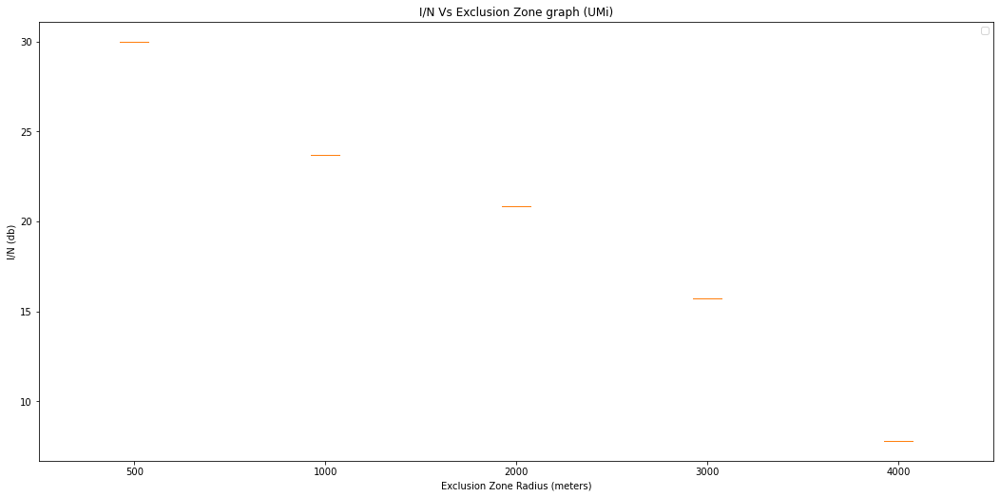

In [31]:
# EXCLUSION ZONE

# Creating dataset
# distance, interface_Noise = pairs_noAverage['UMi']
distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot([interface_Noise[exclusion_zone]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('FSS_8_Higher_48_degree_Omni_graphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [32]:
'''# EXCLUSION ZONE (-15db BS)

# Creating dataset
distance, interface_Noise = pairs_noAverage['UMi']
# distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -5], (#lowest could be -7db)
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('-15dbaggregatedirecgraphUmiexclusion5km.pdf', dpi=100)
plt.show()'''

"# EXCLUSION ZONE (-15db BS)\n\n# Creating dataset\ndistance, interface_Noise = pairs_noAverage['UMi']\n# distance, interface_Noise = pairs['UMi']\n \n# print(box_dict_UMi)\n \nfig, ax = plt.subplots()\n\n# Creating plot\nfor i, exclusion_zone in enumerate(exclusion_zones):\n    # key is exclusion zone\n#     ax.boxplot(interface_Noise[exclusion_zone],\n     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -5], (#lowest could be -7db)\n               patch_artist=True,\n               positions=[i],\n               boxprops=dict(facecolor='white'))\n\n# keys = sorted([key for key in box_dict_UMi])\n# ax.boxplot([box_dict_UMi[key] for key in keys])\nax.set_xticklabels([int(i) for i in exclusion_zones])\n \nax.set_title('I/N Vs Exclusion Zone graph (UMi)')\nax.set_xlabel('Exclusion Zone Radius (meters)')\nax.set_ylabel('I/N (db)')\nax.legend()\n\n# show plot\n# plt.show()\nfig.set_size_inches(18, 8.5)\n# fig.savefig('-15dbaggregatedirecgraphUmiexclusion5km.pdf', dpi=100)\n

In [33]:
len(pairs_noAverage ['UMi'][1][500])/10

33.0

In [34]:
pairs['UMi'][1]

{500: 30.00996434379617,
 1000: 23.681407597233665,
 2000: 20.838980211534327,
 3000: 15.693695037848588,
 4000: 7.794497459761183}

2022-11-08 07:21:19,257 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


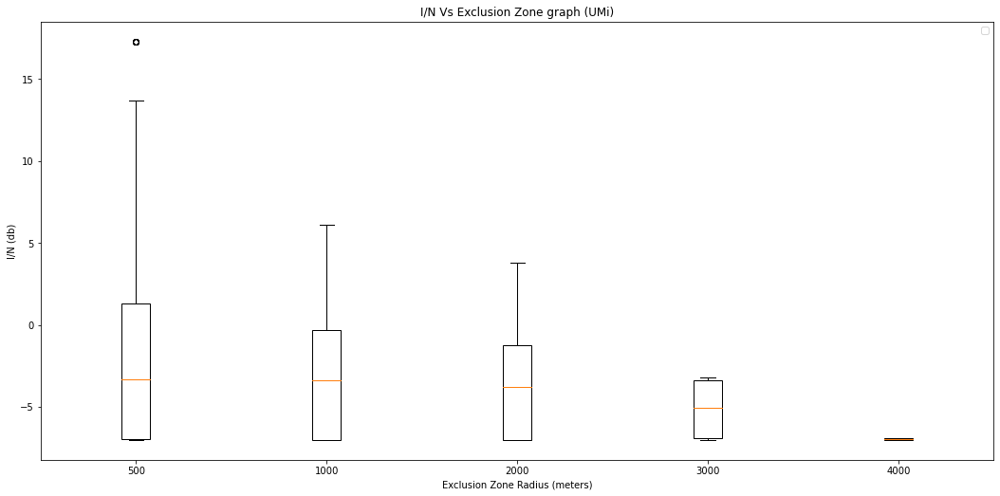

In [35]:
# EXCLUSION ZONE

# Creating dataset
distance, interface_Noise = pairs_noAverage['UMi']
# distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot([interface_Noise[exclusion_zone]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiexclusion.pdf', dpi=100)
plt.show()

In [36]:
# # Creating dataset
# box_dict_UMi = dict{2: I_N_UMi for 2000, 5: I_N_UMi for 5000, 10: I_N_UMi for 10000}
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if not line_of_sight[i]:
#         continue   
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# # print(box_dict_UMi)

# fig, ax= plt.subplots()
 
# # Creating plot
# keys = sorted([key for key in box_dict_UMi])
# for i, key in enumerate(keys):
#     # key is distance
#     # print(key)
#     # print(box_dict_UMi[key])
#     line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
# #     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
# #                patch_artist=True,
# #                positions=[i],
# #                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# # keys = sorted([key for key in box_dict_UMi])
# # ax.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels([int(i) for i in keys])

# ax.set_title('I/N Vs Distance graph (UMi LOS)')
# ax.set_xlabel('Distnace of Each BS from FSS (meters)')
# ax.set_ylabel('I/N (db)')
# ax.legend()
 
# # show plot
# # plt.show()
# fig.set_size_inches(18, 8.5)
# # fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
# plt.show()





In [37]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()
    

KeyError: 2

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUMa.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()